In [1]:
# pip install timm

In [2]:
import torch
import torch.nn as nn
import torch.nn.init as init
import torch.nn.functional as F
import torch.optim as optim
import torchvision.transforms as transforms
from torch.utils.data import Dataset
from skimage.metrics import structural_similarity as ssim
import timm


import re
import random
import numpy as np
import pandas as pd

%matplotlib inline
import matplotlib.pyplot as plt

from glob import glob
from PIL import Image

C:\Users\cmvv5\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated and will be removed in a future release
  "class": algorithms.Blowfish,


In [3]:
def set_seed(seed=22):
    torch.manual_seed(seed)
    np.random.seed(seed)
    random.seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.benchmark = False
    torch.backends.cudnn.deterministic = True

# seed 고정
set_seed(22)

# GPU 사용 설정
train_on_gpu = torch.cuda.is_available()

if not train_on_gpu:
    device = 'cpu'
    print('CUDA is not available.  Training on CPU ...')
else:
    device = 'cuda'
    print('CUDA is available!  Training on GPU ...')



CUDA is available!  Training on GPU ...


In [4]:
class Dataset_train(Dataset):
    def __init__(self, file_dir, transform=None):
        self.input_dir = sorted(glob(file_dir))[0]
        self.lable_dir = sorted(glob(file_dir))[1]
        
        self.input_list = sorted(glob(self.input_dir + '/*.png'))
        self.label_list = sorted(glob(self.lable_dir + '/*.png'))

        self.transform = transform

    def __len__(self):
        return len(self.input_list)
    
    def __getitem__(self, idx):
        image = Image.open(self.input_list[idx]).convert('RGB')
        val = Image.open(self.label_list[idx]).convert('RGB')
        
        if self.transform:
            input = self.transform(image)
            val = self.transform(val)

        return input , val

In [5]:
# pip install imgaug

In [6]:
num_workers = 0
batch_size =  8

transform = transforms.Compose([
    transforms.Resize((420, 540)),  # Resize to (420, 540)
    transforms.Grayscale(),  # Convert to grayscale
    
    # transforms.GaussianBlur(kernel_size=(5, 9), sigma=(1.0, 1.5)),  # Gaussian blur with range
    
    transforms.ToTensor(),  # Convert to tensor
    
])

# Local 환경 데이터셋 폴더 지정 
# dataset = Dataset_train(file_dir='./train/*', transform=transform)

# Kaggle notebook 환경 데이터셋 폴더 지정 
dataset = Dataset_train(file_dir='../Desktop/sw_week/2024-hallym-sw-week-competition/train/*', transform=transform)

# train, validation으로 분할
train_dataset, val_dataset = torch.utils.data.random_split(dataset, [0.8, 0.2])

train_loader = torch.utils.data.DataLoader(train_dataset, batch_size = batch_size, num_workers = num_workers, shuffle = True)
validation_loader = torch.utils.data.DataLoader(val_dataset, batch_size = batch_size, num_workers = num_workers)

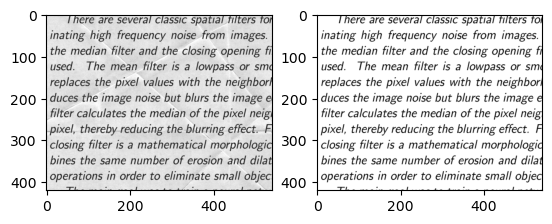

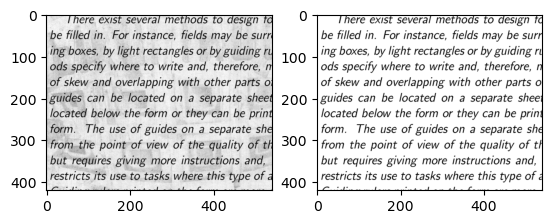

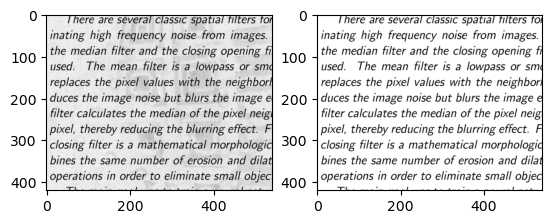

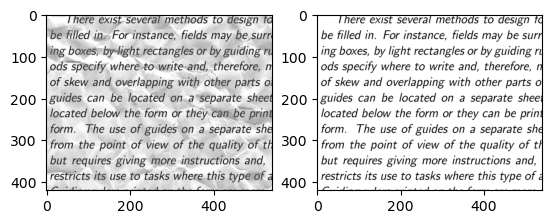

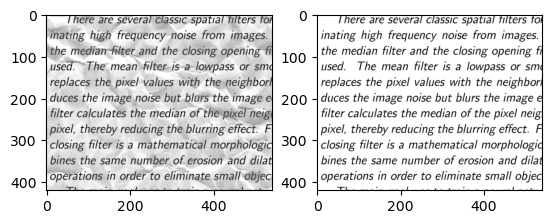

In [7]:
# 1차원 데이터셋 확인
for i in range(5):
    d1 = dataset[i]
    plt.subplot(1,2,1)
    plt.imshow(torch.squeeze(d1[0]), cmap='gray')
    plt.subplot(1,2,2)
    plt.imshow(torch.squeeze(d1[1]), cmap='gray')
    plt.show()

# # 3차원 데이터셋 확인
# for i in range(5):
#     d1 = dataset[i]
#     plt.subplot(1, 2, 1)
#     plt.imshow(d1[0].permute(1, 2, 0))  # (C, H, W) -> (H, W, C)로 변환
#     plt.axis('off')  # 축을 숨깁니다
#     plt.title('Input Image')

#     plt.subplot(1, 2, 2)
#     plt.imshow(d1[1].permute(1, 2, 0))  # (C, H, W) -> (H, W, C)로 변환
#     plt.axis('off')  # 축을 숨깁니다
#     plt.title('Label Image')

#     plt.show()


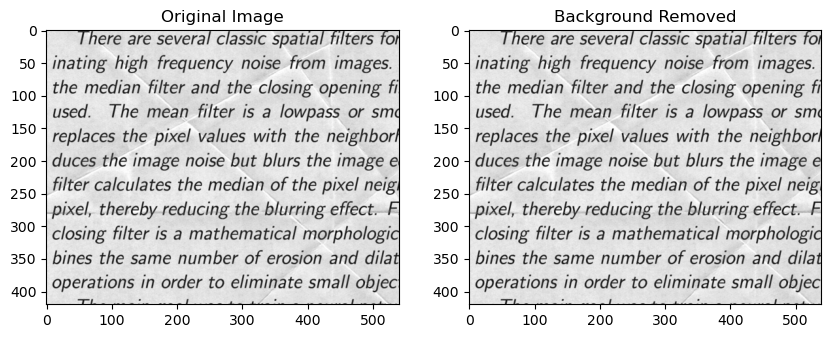

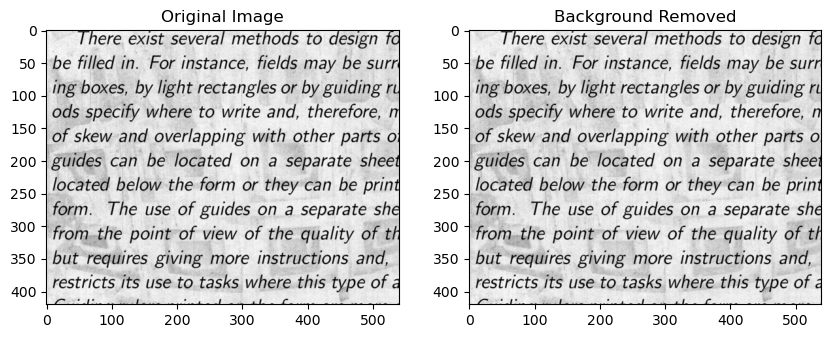

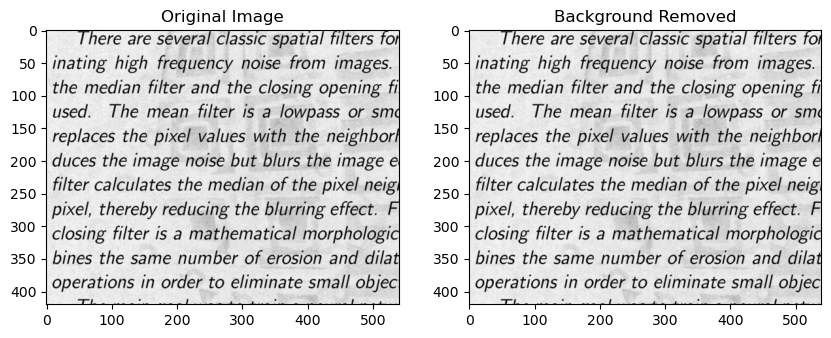

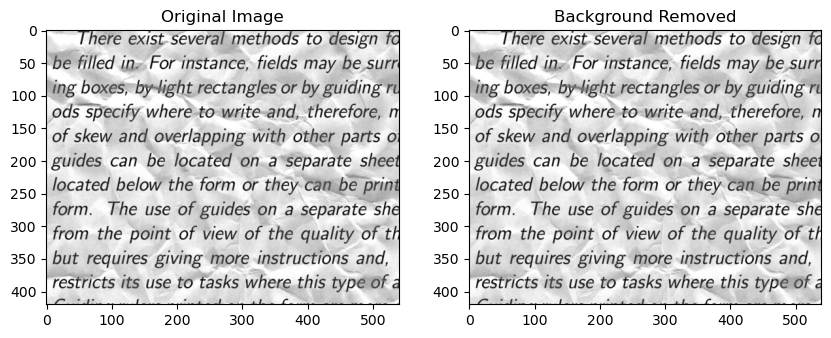

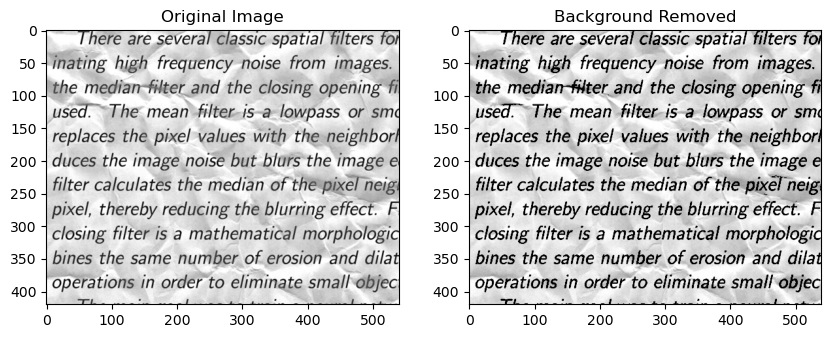

In [8]:
import cv2
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import torch

def remove_background(img):
    # 이미지가 그레이스케일인지 확인하고, 아니라면 변환
    if len(img.shape) == 3 and img.shape[2] == 3:
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    else:
        gray = img  # 이미 그레이스케일인 경우 변환 생략
    
    # 이진화 (Adaptive Thresholding으로 텍스트 영역 강조)
    _, binary = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    
    # 배경 추정: 노이즈로 인한 임계값 왜곡 방지
    background = cv2.medianBlur(binary, 21)
    
    # KMeans를 사용하여 클러스터링으로 텍스트 영역 추출
    pixel_values = background.reshape((-1, 1))
    pixel_values = np.float32(pixel_values)
    
    # 중복 제거
    unique_pixel_values = np.unique(pixel_values, axis=0)
    
    # KMeans 피팅 (샘플 수 확인 후 클러스터 수 조정)
    n_clusters = 2 if len(unique_pixel_values) >= 2 else 1
    kmeans = KMeans(n_clusters=n_clusters, random_state=0, n_init='auto').fit(pixel_values)
    
    # 클러스터 수에 따라 마스크 처리
    if n_clusters == 1:
        mask = np.zeros_like(background, dtype=np.uint8)
        mask[:] = 1  # 모든 픽셀을 같은 클러스터로 설정
    else:
        mask = kmeans.labels_  # kmeans.labels_는 1D 배열로 나옴

    # mask를 원본 배경 크기에 맞게 변환
    mask = mask.reshape(background.shape)

    # 배경 부분을 흰색(255)으로 채우고 텍스트 부분은 그대로 둠
    text_mask = np.where(mask == 1, 255, binary).astype(np.uint8)
    clean_img = cv2.bitwise_and(gray, text_mask)
    
    return clean_img

# 이미지 확인
for i in range(5):
    # 원본 이미지 가져오기
    d1 = dataset[i]
    original_img = d1[0].permute(1, 2, 0).numpy()  # 텐서를 numpy로 변환
    
    # 배경 제거된 이미지 생성
    background_removed_img = remove_background((original_img * 255).astype(np.uint8))
    
    # 이미지 시각화
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(torch.squeeze(d1[0]), cmap='gray')
    plt.title("Original Image")
    
    plt.subplot(1, 2, 2)
    plt.imshow(background_removed_img, cmap='gray')
    plt.title("Background Removed")
    
    plt.show()


In [9]:
# 2. SE 블록 정의
class SEBlock(nn.Module):
    def __init__(self, channel, reduction=16):
        super(SEBlock, self).__init__()
        # reduction이 너무 크지 않도록 최소 1로 설정
        self.reduction = max(1, channel // reduction)
        self.fc1 = nn.Conv2d(channel, self.reduction, kernel_size=1)
        self.fc2 = nn.Conv2d(self.reduction, channel, kernel_size=1)
    
    def forward(self, x):
        y = torch.mean(x, dim=(2, 3), keepdim=True)
        y = torch.relu(self.fc1(y))
        y = torch.sigmoid(self.fc2(y))
        return x * y

In [10]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class MultiLayerAutoencoder(nn.Module):
    def __init__(self):
        super(MultiLayerAutoencoder, self).__init__()
        
        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(1, 32, kernel_size=3, padding='same'),
            nn.LeakyReLU(0.3, inplace=True),
            nn.BatchNorm2d(32),
            nn.Conv2d(32, 64, kernel_size=3, padding='same'),
            nn.LeakyReLU(0.3, inplace=True),
            nn.BatchNorm2d(64),
            nn.Conv2d(64, 64, kernel_size=3, padding='same'),
            nn.LeakyReLU(0.3, inplace=True),
            nn.MaxPool2d(2, stride=2, padding=0)  # Output size: H/2, W/2
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, padding='same'),
            nn.LeakyReLU(0.3, inplace=True),
            nn.BatchNorm2d(64),
            nn.Conv2d(64, 64, kernel_size=3, padding='same'),
            nn.LeakyReLU(0.3, inplace=True),
            nn.Upsample(scale_factor=2, mode='nearest'),
            nn.Conv2d(64, 32, kernel_size=3, padding='same'),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(32, 1, kernel_size=3, padding='same'),
            nn.Sigmoid()
        )

    def forward(self, x):
        original_height = x.size(2)
        
        # Add padding to handle input shape if necessary
        if original_height == 258:
            x = F.pad(x, (0, 0, 0, 2))  # Padding in the height dimension only
        
        x = self.encoder(x)
        x = self.decoder(x)
        
        # Crop the output back to the original shape if padding was added
        if original_height == 258:
            x = x[:, :, :258, :]
        
        return x

# # 테스트 코드
# autoencoder = Autoencoder()
# input_tensor = torch.randn(1, 1, 258, 540)  # 입력 크기: 258x540
# output = autoencoder(input_tensor)
# print("Output shape:", output.shape)


In [11]:
model = MultiLayerAutoencoder().to(device)

# model = TransUNet(num_classes=1, pretrained=True).to(device)

In [12]:
from skimage.metrics import structural_similarity as ssim

class SSIMLoss(nn.Module):
    def __init__(self, win_size=None):
        super(SSIMLoss, self).__init__()
        self.win_size = win_size

    def forward(self, img1, img2):
        # img1, img2의 높이와 너비 중 작은 값을 기준으로 win_size를 설정
        min_dim = min(img1.shape[2], img1.shape[3])
        if self.win_size is None or self.win_size > min_dim:
            # 이미지의 작은 차원이 7 미만일 경우, win_size를 3으로 설정
            win_size = min(3, min_dim if min_dim % 2 == 1 else min_dim - 1)
        else:
            win_size = self.win_size

        return 1 - ssim(
            img1.detach().cpu().numpy(),
            img2.detach().cpu().numpy(),
            data_range=float(img2.max() - img2.min()),
            win_size=win_size,
            channel_axis=1  # 채널 축 설정
        )


In [13]:
learning_rate = 9e-4
num_epoch = 10000
best_loss = float('inf')
total_train_loss = []
total_val_loss = []
total_RMSE = []


class RMSELoss(nn.Module):
    def __init__(self, eps=1e-8):
        super().__init__()
        self.mse = nn.MSELoss()
        self.eps = eps
        
    def forward(self,yhat,y):
        loss = torch.sqrt(self.mse(yhat,y) + self.eps)
        return loss

C:\Users\cmvv5\anaconda3\Lib\site-packages\torch\optim\lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Epoch: 0, Train loss: 0.5063315033912659, validation loss: 0.7099788784980774, validaiton RMSE: 0.2684535086154938
Save new param


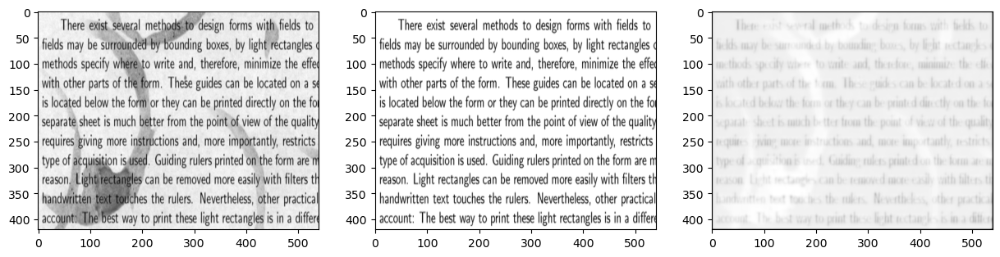

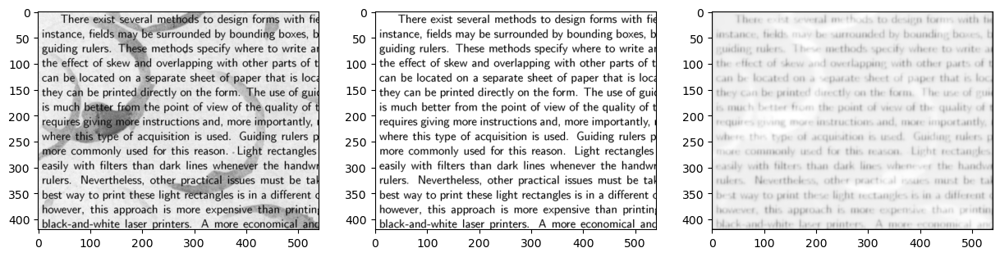

Epoch: 1, Train loss: 0.14783993363380432, validation loss: 0.7494116425514221, validaiton RMSE: 0.2908311188220978
Epoch: 2, Train loss: 0.09811113029718399, validation loss: 0.5426239371299744, validaiton RMSE: 0.23724038898944855
Save new param
Epoch: 3, Train loss: 0.082746721804142, validation loss: 0.2736055254936218, validaiton RMSE: 0.16327260434627533
Save new param
Epoch: 4, Train loss: 0.07628517597913742, validation loss: 0.0842275395989418, validaiton RMSE: 0.07783401757478714
Save new param
Epoch: 5, Train loss: 0.0632568970322609, validation loss: 0.06972910463809967, validaiton RMSE: 0.07337553799152374
Save new param
Epoch: 6, Train loss: 0.056990038603544235, validation loss: 0.06132480502128601, validaiton RMSE: 0.0674908384680748
Save new param
Epoch: 7, Train loss: 0.05227711424231529, validation loss: 0.05027109012007713, validaiton RMSE: 0.05593809112906456
Save new param
Epoch: 8, Train loss: 0.045834317803382874, validation loss: 0.045023009181022644, validaito

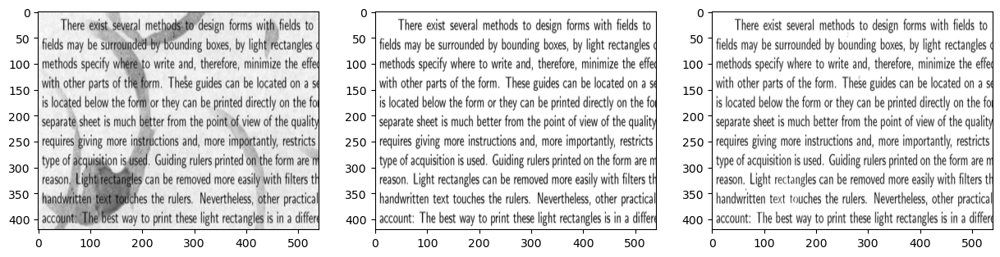

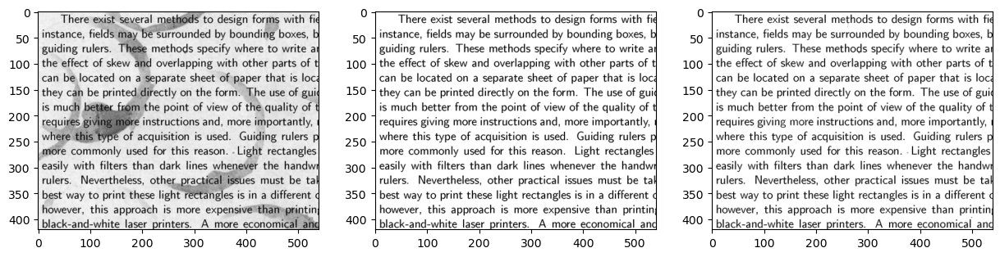

Epoch: 101, Train loss: 0.015131944790482521, validation loss: 0.015877490863204002, validaiton RMSE: 0.027613749727606773
Epoch: 102, Train loss: 0.01467872317880392, validation loss: 0.014989975839853287, validaiton RMSE: 0.02580069936811924
Epoch: 103, Train loss: 0.014870819635689259, validation loss: 0.014303348958492279, validaiton RMSE: 0.025680581107735634
Save new param
Epoch: 104, Train loss: 0.014787972904741764, validation loss: 0.014924694783985615, validaiton RMSE: 0.027245139703154564
Epoch: 105, Train loss: 0.015189696103334427, validation loss: 0.014367975294589996, validaiton RMSE: 0.025625931099057198
Epoch: 106, Train loss: 0.014914226718246937, validation loss: 0.015293876640498638, validaiton RMSE: 0.02565539814531803
Epoch: 107, Train loss: 0.014718213118612766, validation loss: 0.017558319494128227, validaiton RMSE: 0.030353272333741188
Epoch: 108, Train loss: 0.014754683710634708, validation loss: 0.014134708791971207, validaiton RMSE: 0.024903463199734688
Save

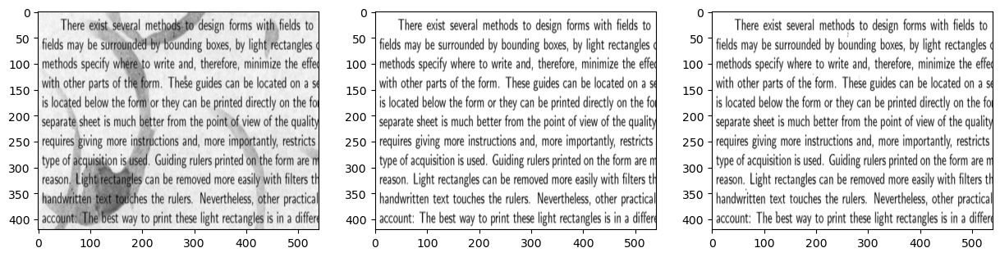

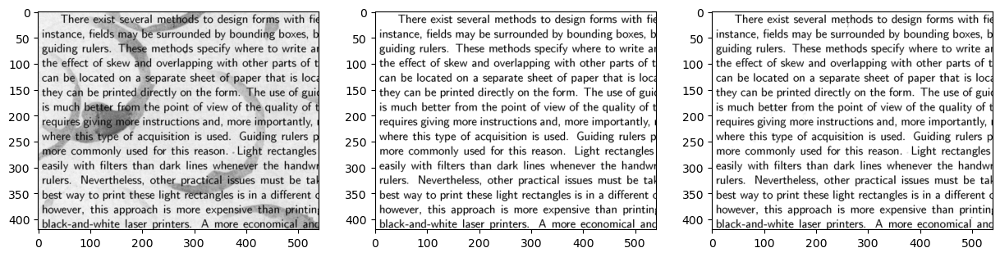

Epoch: 201, Train loss: 0.011828010901808739, validation loss: 0.01320960745215416, validaiton RMSE: 0.025439860299229622
Epoch: 202, Train loss: 0.012850495986640453, validation loss: 0.012650027871131897, validaiton RMSE: 0.024060221388936043
Epoch: 203, Train loss: 0.014022570103406906, validation loss: 0.01351357251405716, validaiton RMSE: 0.025049535557627678
Epoch: 204, Train loss: 0.012618270702660084, validation loss: 0.01432542409747839, validaiton RMSE: 0.027764232829213142
Epoch: 205, Train loss: 0.011951417662203312, validation loss: 0.012416365556418896, validaiton RMSE: 0.022680064663290977
Epoch: 206, Train loss: 0.012061658315360546, validation loss: 0.011694242246448994, validaiton RMSE: 0.02235051989555359
Epoch: 207, Train loss: 0.012550432235002518, validation loss: 0.013592678122222424, validaiton RMSE: 0.025533929467201233
Epoch: 208, Train loss: 0.013761685229837894, validation loss: 0.023000521585345268, validaiton RMSE: 0.03503110259771347
Epoch: 209, Train los

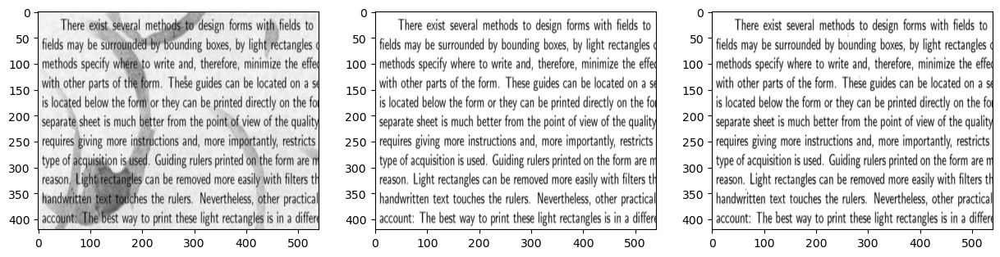

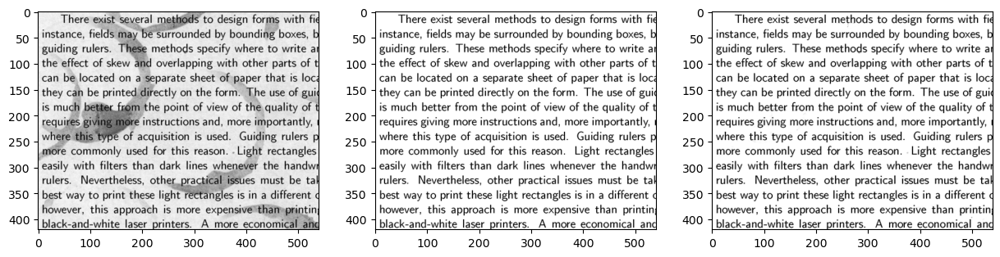

Epoch: 301, Train loss: 0.010427037253975868, validation loss: 0.010492753237485886, validaiton RMSE: 0.020645739510655403
Epoch: 302, Train loss: 0.010534525848925114, validation loss: 0.011225477792322636, validaiton RMSE: 0.02250041998922825
Epoch: 303, Train loss: 0.010231620632112026, validation loss: 0.01100238412618637, validaiton RMSE: 0.021663926541805267
Epoch: 304, Train loss: 0.010907032527029514, validation loss: 0.01201238576322794, validaiton RMSE: 0.02321534790098667
Epoch: 305, Train loss: 0.011335707269608974, validation loss: 0.010665957815945148, validaiton RMSE: 0.02007184736430645
Epoch: 306, Train loss: 0.010651982389390469, validation loss: 0.010775521397590637, validaiton RMSE: 0.022215431556105614
Epoch: 307, Train loss: 0.010689808055758476, validation loss: 0.011340729892253876, validaiton RMSE: 0.022075392305850983
Epoch: 308, Train loss: 0.011125000193715096, validation loss: 0.010850080288946629, validaiton RMSE: 0.02097979746758938
Epoch: 309, Train loss

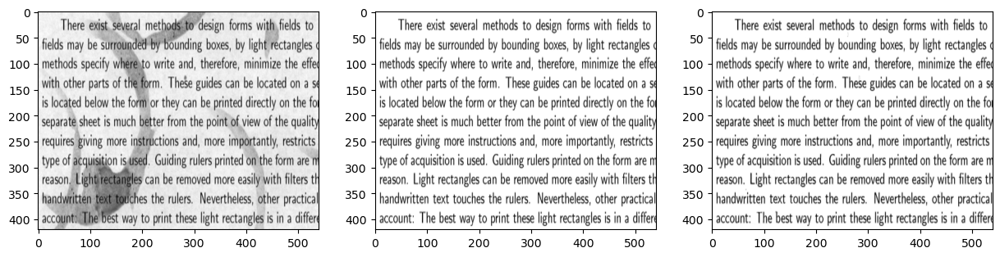

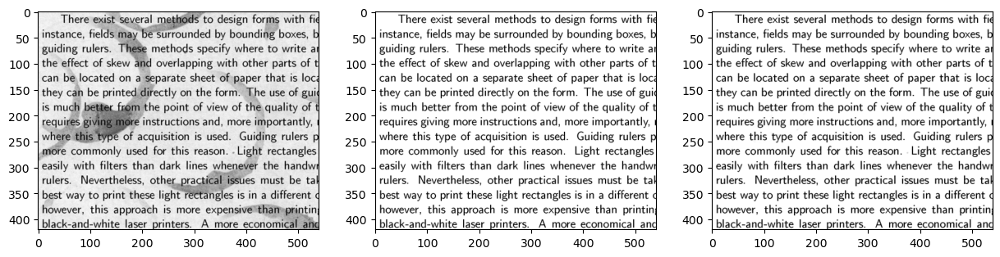

Epoch: 401, Train loss: 0.010186589322984219, validation loss: 0.011449933052062988, validaiton RMSE: 0.0238529983907938
Epoch: 402, Train loss: 0.010174443945288658, validation loss: 0.00955909863114357, validaiton RMSE: 0.019307022914290428
Epoch: 403, Train loss: 0.009790578857064247, validation loss: 0.011676370166242123, validaiton RMSE: 0.02323605678975582
Epoch: 404, Train loss: 0.010230579413473606, validation loss: 0.010179600678384304, validaiton RMSE: 0.018859053030610085
Epoch: 405, Train loss: 0.009315792471170425, validation loss: 0.009884722530841827, validaiton RMSE: 0.02077651210129261
Epoch: 406, Train loss: 0.009667674079537392, validation loss: 0.00944207888096571, validaiton RMSE: 0.01889421045780182
Epoch: 407, Train loss: 0.009703373536467552, validation loss: 0.010873447172343731, validaiton RMSE: 0.01973259262740612
Epoch: 408, Train loss: 0.010151490569114685, validation loss: 0.012665647082030773, validaiton RMSE: 0.025181248784065247
Epoch: 409, Train loss: 

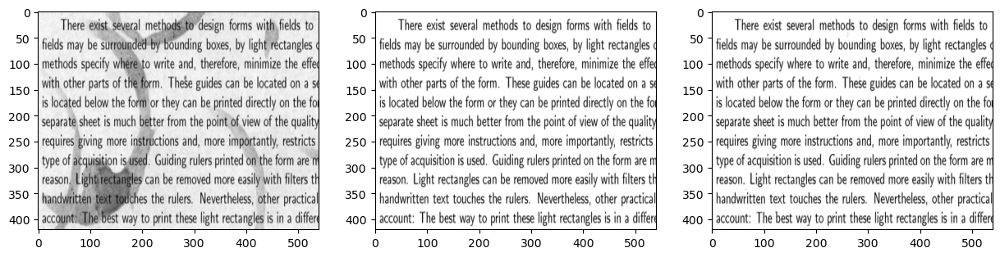

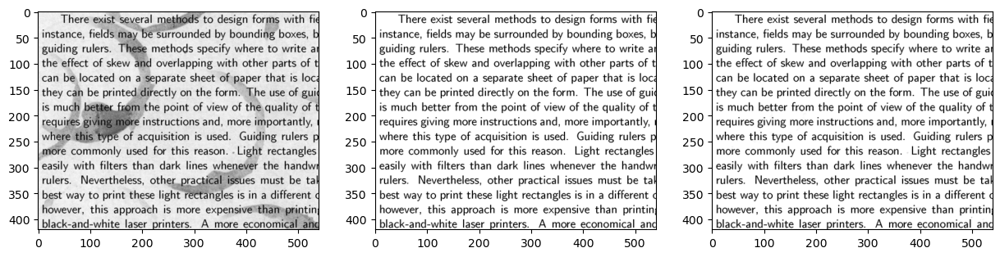

Epoch: 501, Train loss: 0.008122694678604603, validation loss: 0.008235335350036621, validaiton RMSE: 0.01688370108604431
Epoch: 502, Train loss: 0.008133051916956902, validation loss: 0.00825594738125801, validaiton RMSE: 0.01688513718545437
Epoch: 503, Train loss: 0.008370283991098404, validation loss: 0.008229201659560204, validaiton RMSE: 0.016900623217225075
Epoch: 504, Train loss: 0.008332645520567894, validation loss: 0.008248705416917801, validaiton RMSE: 0.016953853890299797
Epoch: 505, Train loss: 0.008256158791482449, validation loss: 0.008302122354507446, validaiton RMSE: 0.016920318827033043
Epoch: 506, Train loss: 0.008317029103636742, validation loss: 0.008246743120253086, validaiton RMSE: 0.016999293118715286
Epoch: 507, Train loss: 0.008213415741920471, validation loss: 0.008224901743233204, validaiton RMSE: 0.01685710810124874
Save new param
Epoch: 508, Train loss: 0.008531948551535606, validation loss: 0.008214506320655346, validaiton RMSE: 0.01687539555132389
Save n

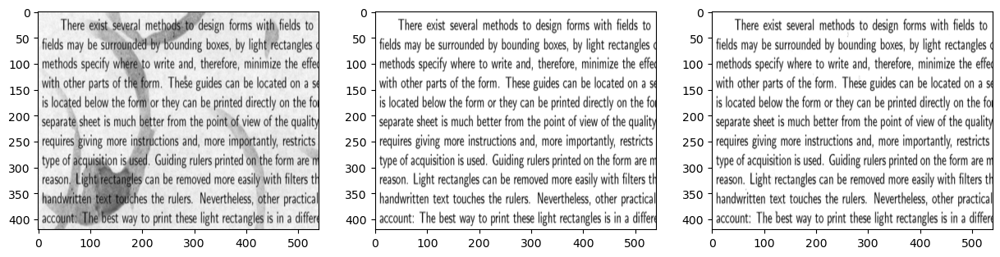

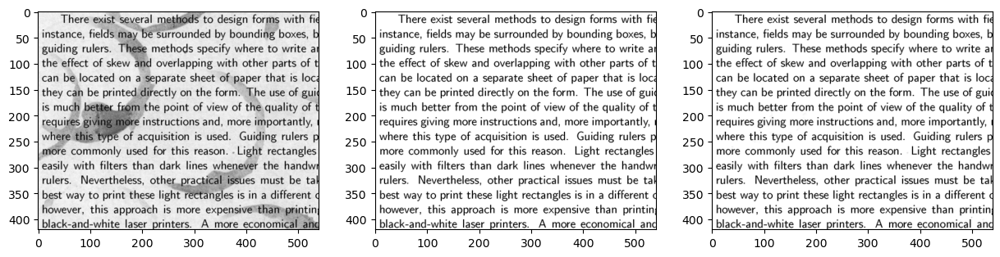

Epoch: 601, Train loss: 0.007951665669679642, validation loss: 0.008047536946833134, validaiton RMSE: 0.016859300434589386
Epoch: 602, Train loss: 0.007963270880281925, validation loss: 0.008109292946755886, validaiton RMSE: 0.016796447336673737
Epoch: 603, Train loss: 0.008164399303495884, validation loss: 0.008039209991693497, validaiton RMSE: 0.016731515526771545
Epoch: 604, Train loss: 0.008036377839744091, validation loss: 0.00799474585801363, validaiton RMSE: 0.016628127545118332
Save new param
Epoch: 605, Train loss: 0.008036132901906967, validation loss: 0.008058223873376846, validaiton RMSE: 0.01667640544474125
Epoch: 606, Train loss: 0.007930462248623371, validation loss: 0.00803737249225378, validaiton RMSE: 0.016773246228694916
Epoch: 607, Train loss: 0.008385644294321537, validation loss: 0.008034280501306057, validaiton RMSE: 0.016689607873558998
Epoch: 608, Train loss: 0.007940604351460934, validation loss: 0.008034446276724339, validaiton RMSE: 0.01665361039340496
Epoch

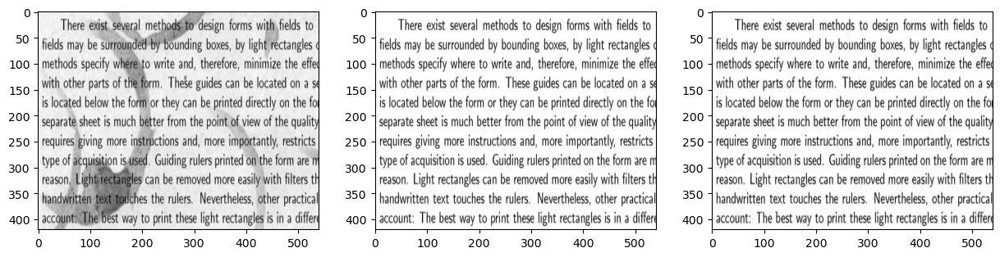

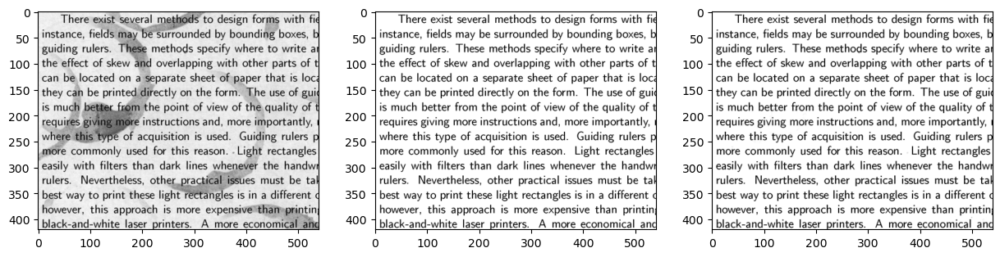

Epoch: 701, Train loss: 0.007772720884531736, validation loss: 0.007914996705949306, validaiton RMSE: 0.016618836671113968
Epoch: 702, Train loss: 0.007573157083243132, validation loss: 0.007936045527458191, validaiton RMSE: 0.016444789245724678
Epoch: 703, Train loss: 0.007883346639573574, validation loss: 0.007857085205614567, validaiton RMSE: 0.016363857313990593
Epoch: 704, Train loss: 0.008000368252396584, validation loss: 0.007871613837778568, validaiton RMSE: 0.01649502106010914
Epoch: 705, Train loss: 0.00761415483430028, validation loss: 0.007858642376959324, validaiton RMSE: 0.0164925679564476
Epoch: 706, Train loss: 0.007730469573289156, validation loss: 0.007879751734435558, validaiton RMSE: 0.01649078167974949
Epoch: 707, Train loss: 0.007743418216705322, validation loss: 0.007987831719219685, validaiton RMSE: 0.016473259776830673
Epoch: 708, Train loss: 0.007738378364592791, validation loss: 0.007777502294629812, validaiton RMSE: 0.01636449620127678
Save new param
Epoch: 

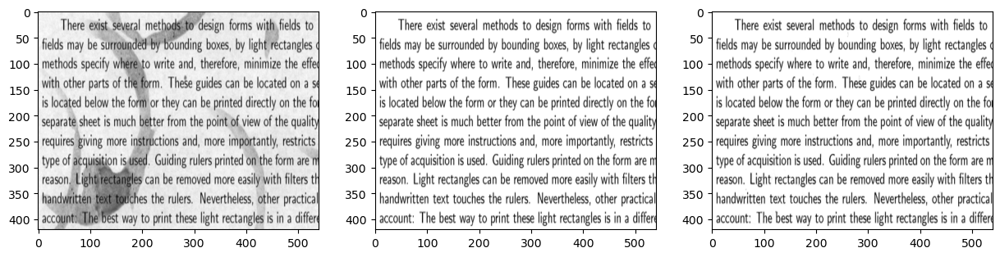

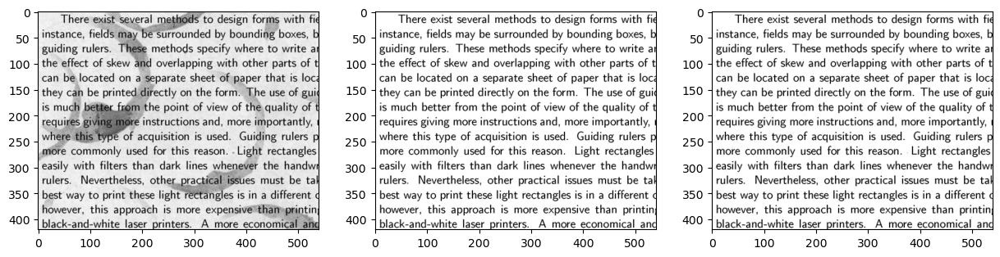

Epoch: 801, Train loss: 0.0076780603267252445, validation loss: 0.007640473544597626, validaiton RMSE: 0.016124971210956573
Epoch: 802, Train loss: 0.007588595151901245, validation loss: 0.007742989808320999, validaiton RMSE: 0.01629921980202198
Epoch: 803, Train loss: 0.007746119983494282, validation loss: 0.007654428482055664, validaiton RMSE: 0.016136212274432182
Epoch: 804, Train loss: 0.007865301333367825, validation loss: 0.007992629893124104, validaiton RMSE: 0.017259487882256508
Epoch: 805, Train loss: 0.007840475998818874, validation loss: 0.007740935310721397, validaiton RMSE: 0.01627103053033352
Epoch: 806, Train loss: 0.007847129367291927, validation loss: 0.007740164641290903, validaiton RMSE: 0.01640515960752964
Epoch: 807, Train loss: 0.007579499389976263, validation loss: 0.007856677286326885, validaiton RMSE: 0.016261214390397072
Epoch: 808, Train loss: 0.007536074612289667, validation loss: 0.007611377630382776, validaiton RMSE: 0.01614401303231716
Save new param
Epoc

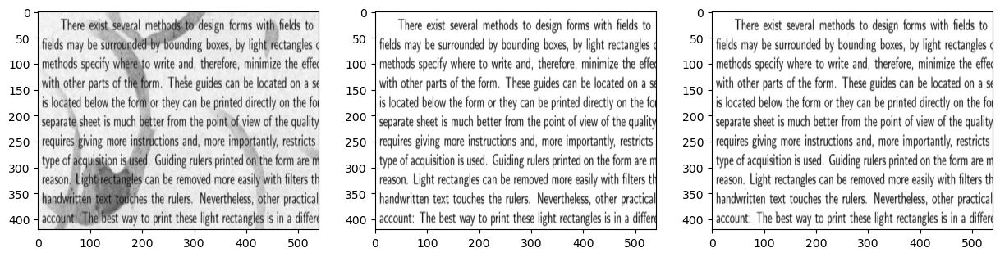

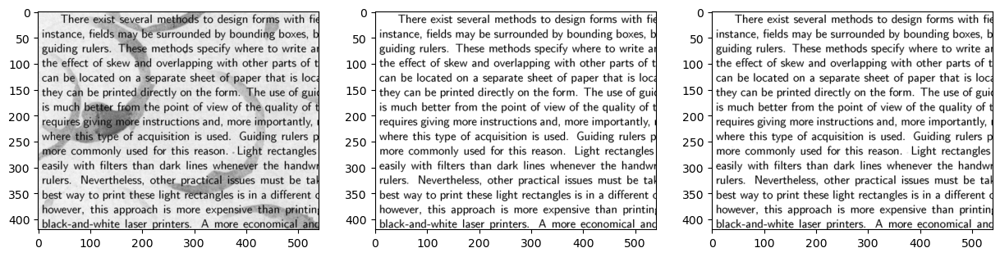

Epoch: 901, Train loss: 0.007596780080348253, validation loss: 0.007664624601602554, validaiton RMSE: 0.016274722293019295
Epoch: 902, Train loss: 0.007609724998474121, validation loss: 0.007545869797468185, validaiton RMSE: 0.015892131254076958
Epoch: 903, Train loss: 0.007534461095929146, validation loss: 0.007559395860880613, validaiton RMSE: 0.016214793547987938
Epoch: 904, Train loss: 0.007708400953561068, validation loss: 0.007747815456241369, validaiton RMSE: 0.016065431758761406
Epoch: 905, Train loss: 0.007698386907577515, validation loss: 0.007530017290264368, validaiton RMSE: 0.016029413789510727
Epoch: 906, Train loss: 0.007787114009261131, validation loss: 0.007608351763337851, validaiton RMSE: 0.01642056554555893
Epoch: 907, Train loss: 0.007515840232372284, validation loss: 0.007834394462406635, validaiton RMSE: 0.01630331017076969
Epoch: 908, Train loss: 0.0075763193890452385, validation loss: 0.007441853638738394, validaiton RMSE: 0.015903718769550323
Save new param
Ep

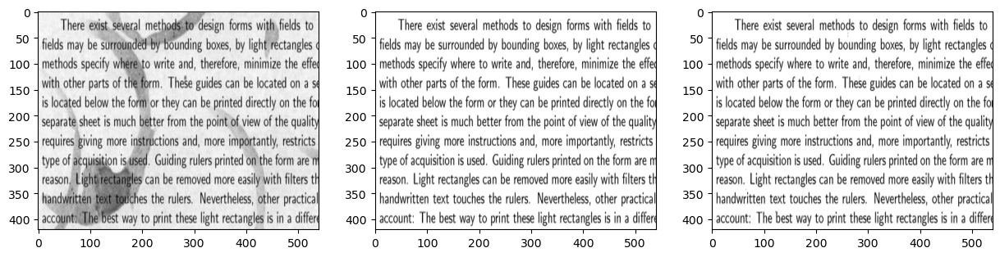

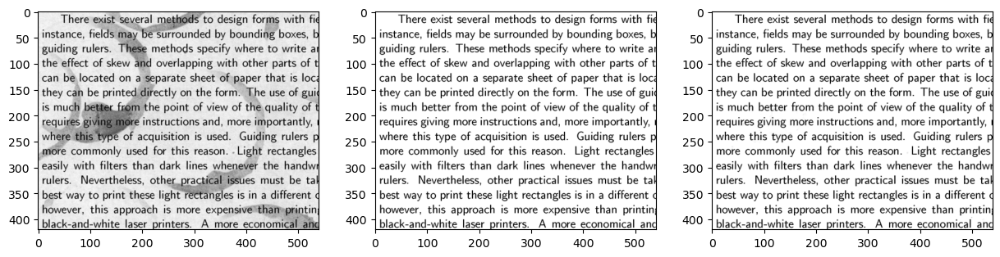

Epoch: 1001, Train loss: 0.007324241567403078, validation loss: 0.007395888213068247, validaiton RMSE: 0.016059136018157005
Epoch: 1002, Train loss: 0.0072997272945940495, validation loss: 0.007477052044123411, validaiton RMSE: 0.015990683808922768
Epoch: 1003, Train loss: 0.0073242937214672565, validation loss: 0.007927663624286652, validaiton RMSE: 0.016638055443763733
Epoch: 1004, Train loss: 0.007508729584515095, validation loss: 0.007451105862855911, validaiton RMSE: 0.016160689294338226
Epoch: 1005, Train loss: 0.007475800346583128, validation loss: 0.007371897343546152, validaiton RMSE: 0.015757737681269646
Epoch: 1006, Train loss: 0.007370838895440102, validation loss: 0.007510537281632423, validaiton RMSE: 0.0158881563693285
Epoch: 1007, Train loss: 0.007311148568987846, validation loss: 0.007581004407256842, validaiton RMSE: 0.0159317497164011
Epoch: 1008, Train loss: 0.007467548828572035, validation loss: 0.007364299148321152, validaiton RMSE: 0.015706924721598625
Epoch: 100

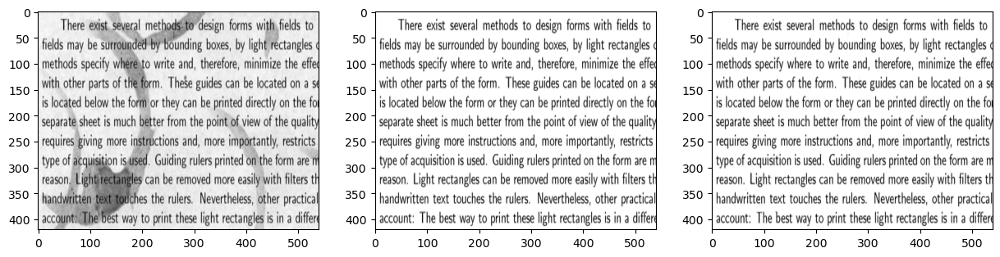

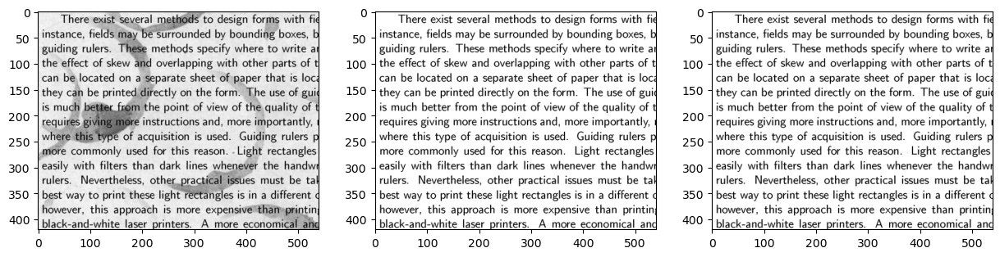

Epoch: 1101, Train loss: 0.007108178921043873, validation loss: 0.007436854299157858, validaiton RMSE: 0.015718096867203712
Epoch: 1102, Train loss: 0.0071714650839567184, validation loss: 0.007412661332637072, validaiton RMSE: 0.01593618467450142
Epoch: 1103, Train loss: 0.007468328345566988, validation loss: 0.007389077451080084, validaiton RMSE: 0.015848742797970772
Epoch: 1104, Train loss: 0.007033431436866522, validation loss: 0.007261801511049271, validaiton RMSE: 0.015686409547924995
Epoch: 1105, Train loss: 0.007235375232994556, validation loss: 0.007351958658546209, validaiton RMSE: 0.015595882199704647
Epoch: 1106, Train loss: 0.007350973319262266, validation loss: 0.007233855780214071, validaiton RMSE: 0.015635209158062935
Epoch: 1107, Train loss: 0.0071361735463142395, validation loss: 0.007392715662717819, validaiton RMSE: 0.015704859048128128
Epoch: 1108, Train loss: 0.007402448449283838, validation loss: 0.007405836600810289, validaiton RMSE: 0.016060704365372658
Epoch: 

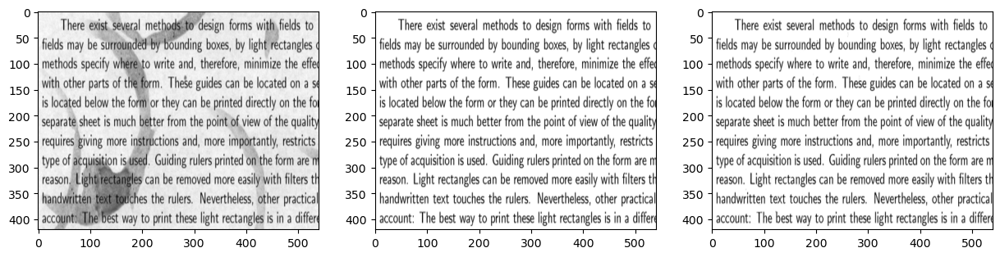

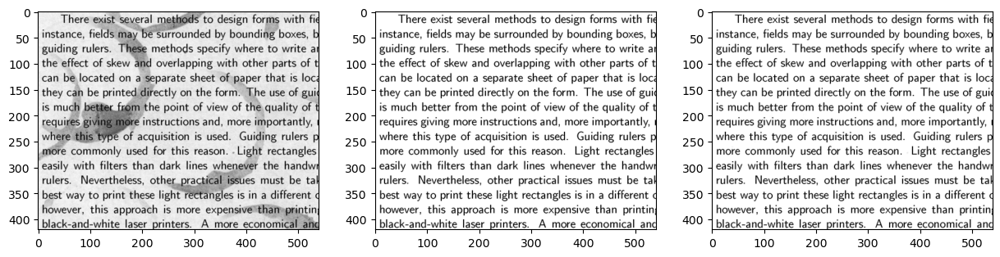

Epoch: 1201, Train loss: 0.00747957406565547, validation loss: 0.0071565196849405766, validaiton RMSE: 0.015587947331368923
Epoch: 1202, Train loss: 0.007313866633921862, validation loss: 0.007546952459961176, validaiton RMSE: 0.01631893217563629
Epoch: 1203, Train loss: 0.007012592162936926, validation loss: 0.00750824436545372, validaiton RMSE: 0.01568593643605709
Epoch: 1204, Train loss: 0.007160982582718134, validation loss: 0.00723573612049222, validaiton RMSE: 0.015709342435002327
Epoch: 1205, Train loss: 0.007336764130741358, validation loss: 0.007201566826552153, validaiton RMSE: 0.01576307788491249
Epoch: 1206, Train loss: 0.0075209615752100945, validation loss: 0.007271662820130587, validaiton RMSE: 0.015763767063617706
Epoch: 1207, Train loss: 0.007233125157654285, validation loss: 0.0073909759521484375, validaiton RMSE: 0.015911299735307693
Epoch: 1208, Train loss: 0.007174092810600996, validation loss: 0.007199921179562807, validaiton RMSE: 0.015500272624194622
Epoch: 1209

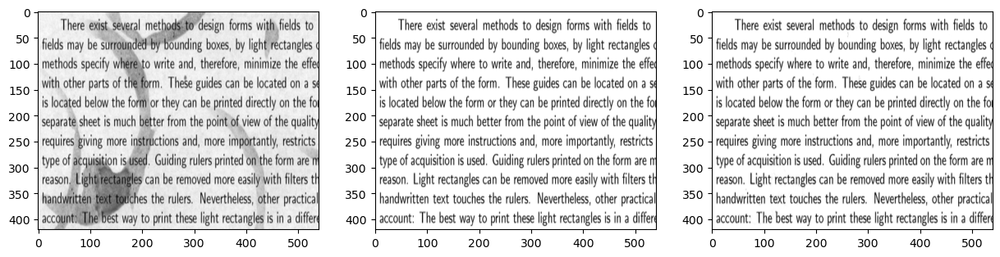

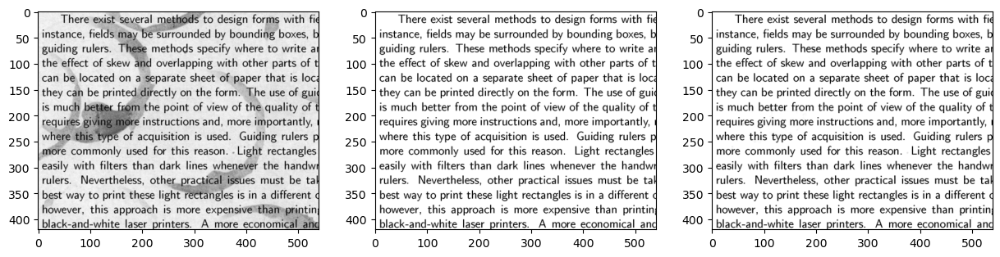

Epoch: 1301, Train loss: 0.0072205024771392345, validation loss: 0.00724844029173255, validaiton RMSE: 0.015406417660415173
Epoch: 1302, Train loss: 0.007437007036060095, validation loss: 0.0071122595109045506, validaiton RMSE: 0.01547494251281023
Epoch: 1303, Train loss: 0.007120274472981691, validation loss: 0.007677905261516571, validaiton RMSE: 0.016606608405709267
Epoch: 1304, Train loss: 0.007216839585453272, validation loss: 0.007349494844675064, validaiton RMSE: 0.01638653874397278
Epoch: 1305, Train loss: 0.007115655113011599, validation loss: 0.007342295255511999, validaiton RMSE: 0.01610661670565605
Epoch: 1306, Train loss: 0.006984393112361431, validation loss: 0.007248045410960913, validaiton RMSE: 0.015564002096652985
Epoch: 1307, Train loss: 0.007011474575847387, validation loss: 0.007197612896561623, validaiton RMSE: 0.015508371405303478
Epoch: 1308, Train loss: 0.007115859072655439, validation loss: 0.00725932652130723, validaiton RMSE: 0.0159778855741024
Epoch: 1309, 

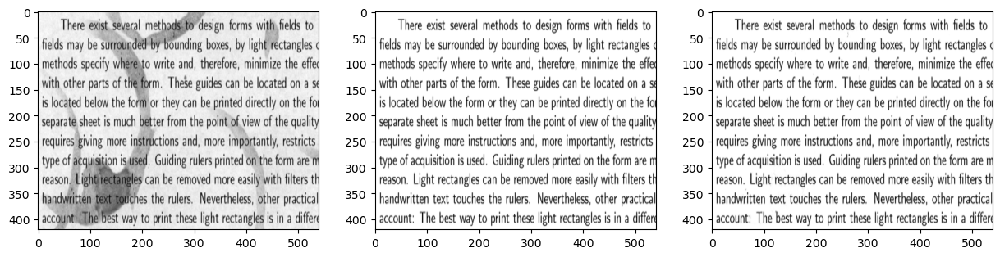

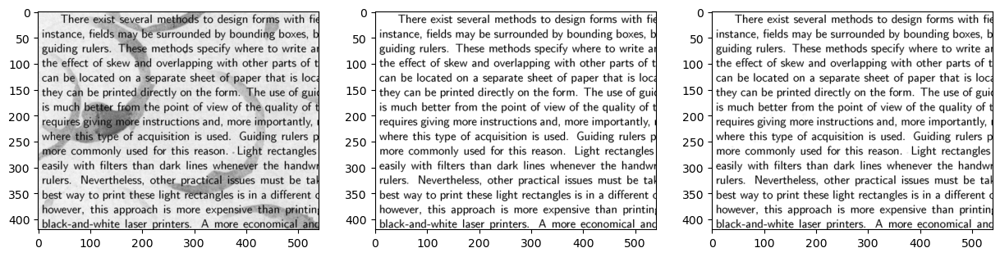

Epoch: 1401, Train loss: 0.006915820762515068, validation loss: 0.0070419651456177235, validaiton RMSE: 0.015237913466989994
Epoch: 1402, Train loss: 0.0070213512517511845, validation loss: 0.007013452704995871, validaiton RMSE: 0.015559911727905273
Epoch: 1403, Train loss: 0.007383397314697504, validation loss: 0.00739043764770031, validaiton RMSE: 0.016725312918424606
Epoch: 1404, Train loss: 0.007023720070719719, validation loss: 0.007216935511678457, validaiton RMSE: 0.015508417971432209
Epoch: 1405, Train loss: 0.0070134238339960575, validation loss: 0.007318461779505014, validaiton RMSE: 0.016302743926644325
Epoch: 1406, Train loss: 0.0070074815303087234, validation loss: 0.007122559007257223, validaiton RMSE: 0.01554985623806715
Epoch: 1407, Train loss: 0.006826364900916815, validation loss: 0.00710473395884037, validaiton RMSE: 0.015237758867442608
Epoch: 1408, Train loss: 0.006872318219393492, validation loss: 0.0071928962133824825, validaiton RMSE: 0.0154094398021698
Epoch: 1

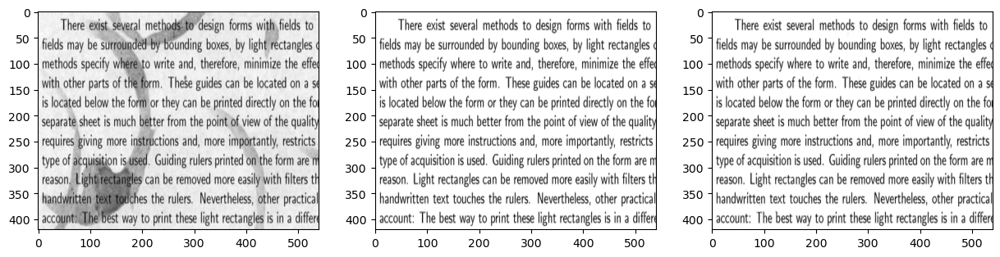

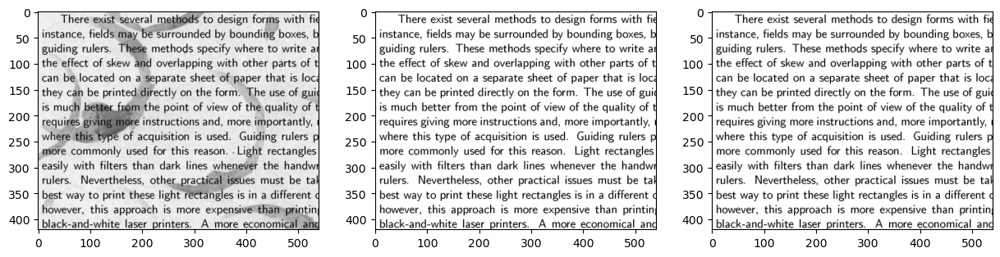

Epoch: 1501, Train loss: 0.006950173992663622, validation loss: 0.007075273897498846, validaiton RMSE: 0.01532504241913557
Epoch: 1502, Train loss: 0.007020242977887392, validation loss: 0.007149150129407644, validaiton RMSE: 0.015276300720870495
Epoch: 1503, Train loss: 0.006729829125106335, validation loss: 0.007024722173810005, validaiton RMSE: 0.015145624987781048
Epoch: 1504, Train loss: 0.006952054798603058, validation loss: 0.006934860721230507, validaiton RMSE: 0.01506174448877573
Epoch: 1505, Train loss: 0.007031490094959736, validation loss: 0.006893487181514502, validaiton RMSE: 0.015048518776893616
Epoch: 1506, Train loss: 0.006809137295931578, validation loss: 0.006894504651427269, validaiton RMSE: 0.015069857239723206
Epoch: 1507, Train loss: 0.006845728028565645, validation loss: 0.006893786136060953, validaiton RMSE: 0.015048548579216003
Epoch: 1508, Train loss: 0.006861788220703602, validation loss: 0.006894012447446585, validaiton RMSE: 0.015049406327307224
Epoch: 150

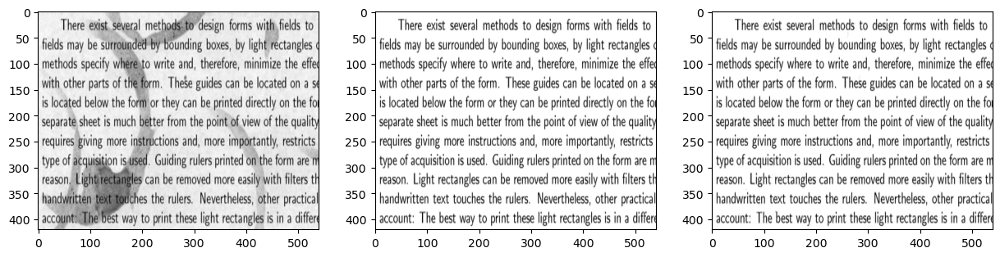

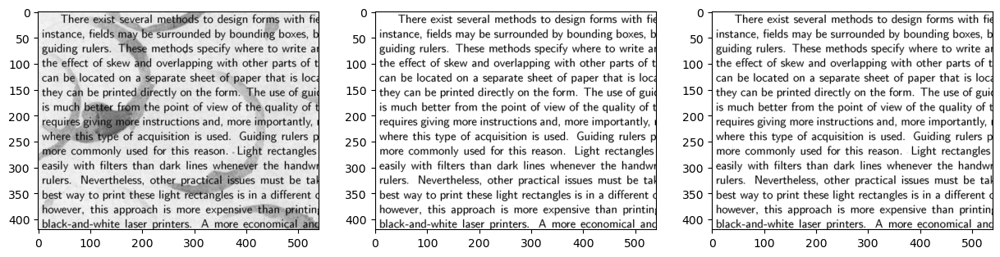

Epoch: 1601, Train loss: 0.006862959358841181, validation loss: 0.00687939440831542, validaiton RMSE: 0.01503407210111618
Epoch: 1602, Train loss: 0.0067630368284881115, validation loss: 0.006874886807054281, validaiton RMSE: 0.015028230845928192
Epoch: 1603, Train loss: 0.0067761908285319805, validation loss: 0.006881318986415863, validaiton RMSE: 0.015023323707282543
Epoch: 1604, Train loss: 0.006696684285998344, validation loss: 0.006872077938169241, validaiton RMSE: 0.015028626658022404
Epoch: 1605, Train loss: 0.0067797210067510605, validation loss: 0.006875667721033096, validaiton RMSE: 0.015035013668239117
Epoch: 1606, Train loss: 0.006759051699191332, validation loss: 0.006887983996421099, validaiton RMSE: 0.01503803115338087
Epoch: 1607, Train loss: 0.006671961862593889, validation loss: 0.00688547408208251, validaiton RMSE: 0.01503463089466095
Epoch: 1608, Train loss: 0.006707354914397001, validation loss: 0.006888604257255793, validaiton RMSE: 0.0150319067761302
Epoch: 1609,

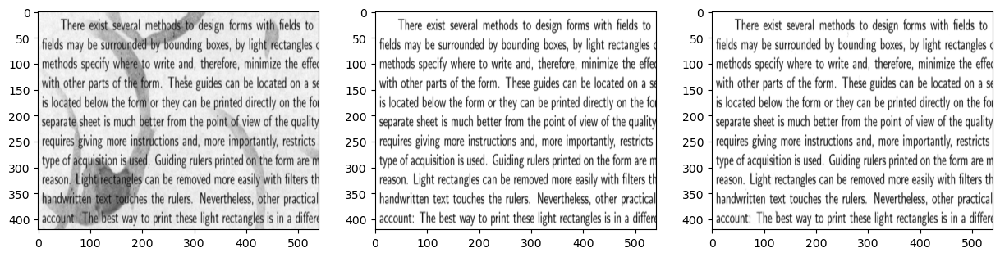

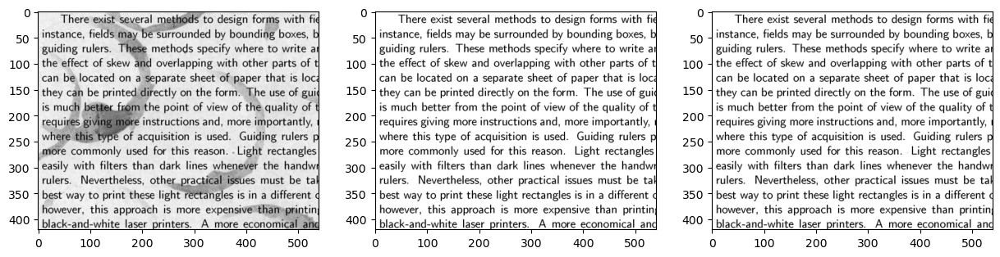

Epoch: 1701, Train loss: 0.006683893967419863, validation loss: 0.006875516381114721, validaiton RMSE: 0.015022140927612782
Epoch: 1702, Train loss: 0.0068205283023417, validation loss: 0.006869006436318159, validaiton RMSE: 0.015020444989204407
Epoch: 1703, Train loss: 0.006652006879448891, validation loss: 0.006886783521622419, validaiton RMSE: 0.01503269374370575
Epoch: 1704, Train loss: 0.006744812708348036, validation loss: 0.006869513541460037, validaiton RMSE: 0.01501185167580843
Epoch: 1705, Train loss: 0.006649657618254423, validation loss: 0.006863064598292112, validaiton RMSE: 0.015013677068054676
Epoch: 1706, Train loss: 0.0067266481928527355, validation loss: 0.006874809507280588, validaiton RMSE: 0.015012439340353012
Epoch: 1707, Train loss: 0.006750276777893305, validation loss: 0.0068609644658863544, validaiton RMSE: 0.015019292943179607
Epoch: 1708, Train loss: 0.006747646722942591, validation loss: 0.006860682275146246, validaiton RMSE: 0.0150102898478508
Epoch: 1709,

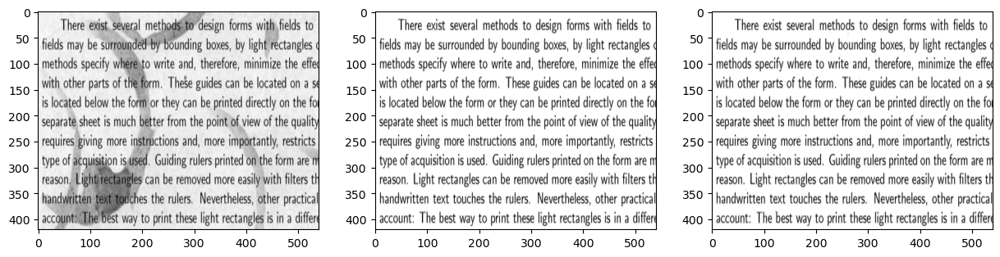

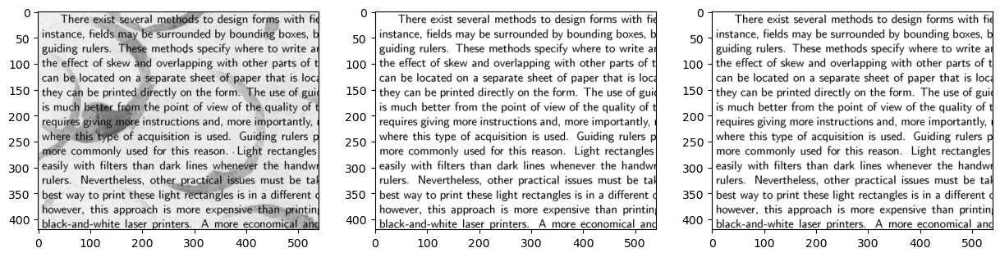

Epoch: 1801, Train loss: 0.0066925110295414925, validation loss: 0.00687526585534215, validaiton RMSE: 0.015009805560112
Epoch: 1802, Train loss: 0.006689724512398243, validation loss: 0.006871753837913275, validaiton RMSE: 0.015009913593530655
Epoch: 1803, Train loss: 0.006983981933444738, validation loss: 0.006865717004984617, validaiton RMSE: 0.015005993656814098
Epoch: 1804, Train loss: 0.006720653269439936, validation loss: 0.0068697091192007065, validaiton RMSE: 0.015011285431683064
Epoch: 1805, Train loss: 0.006771640852093697, validation loss: 0.006865269038826227, validaiton RMSE: 0.01501418650150299
Epoch: 1806, Train loss: 0.006835698615759611, validation loss: 0.006874037440866232, validaiton RMSE: 0.01502377912402153
Epoch: 1807, Train loss: 0.006712396163493395, validation loss: 0.006871391087770462, validaiton RMSE: 0.015013758093118668
Epoch: 1808, Train loss: 0.00673384265974164, validation loss: 0.006868403404951096, validaiton RMSE: 0.015014812350273132
Epoch: 1809, 

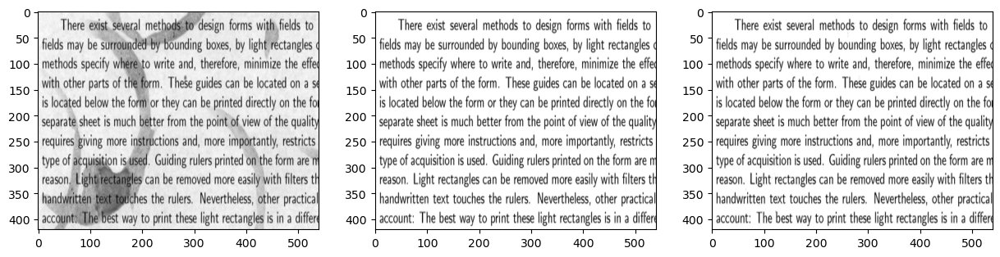

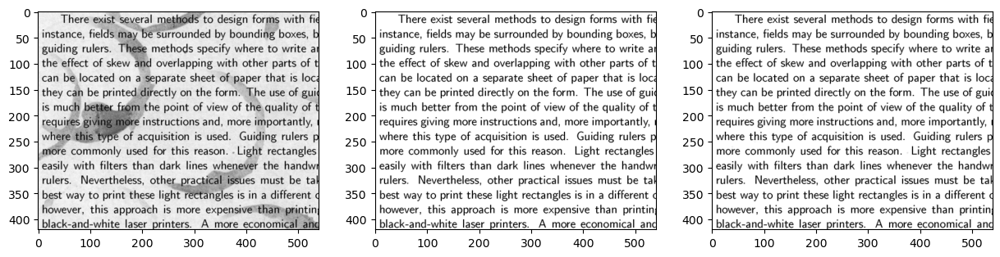

Epoch: 1901, Train loss: 0.006709736306220293, validation loss: 0.00686267763376236, validaiton RMSE: 0.01500540878623724
Epoch: 1902, Train loss: 0.006752537097781897, validation loss: 0.0068703568540513515, validaiton RMSE: 0.015019618906080723
Epoch: 1903, Train loss: 0.0067393784411251545, validation loss: 0.006871393416076899, validaiton RMSE: 0.015027708373963833
Epoch: 1904, Train loss: 0.006880901288241148, validation loss: 0.006869209464639425, validaiton RMSE: 0.015019900165498257
Epoch: 1905, Train loss: 0.006814353633671999, validation loss: 0.006871385499835014, validaiton RMSE: 0.015022198669612408
Epoch: 1906, Train loss: 0.006761704105883837, validation loss: 0.006867659743875265, validaiton RMSE: 0.01500861719250679
Epoch: 1907, Train loss: 0.006860833149403334, validation loss: 0.00687061995267868, validaiton RMSE: 0.015019163489341736
Epoch: 1908, Train loss: 0.006842773873358965, validation loss: 0.006866218987852335, validaiton RMSE: 0.015015403740108013
Epoch: 190

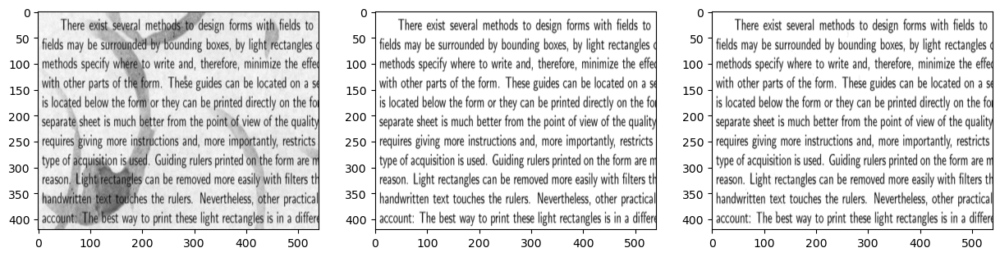

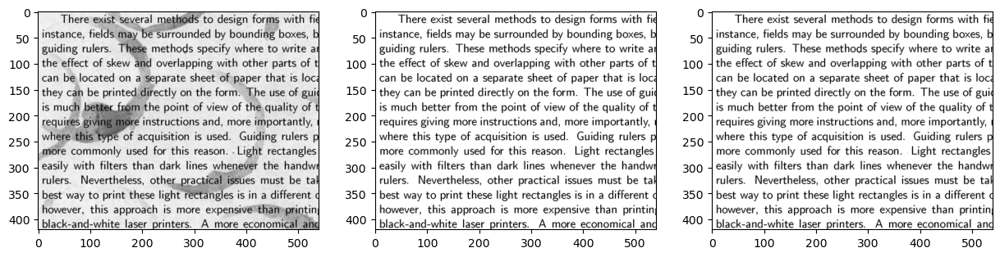

Epoch: 2001, Train loss: 0.0069091483019292355, validation loss: 0.006863148882985115, validaiton RMSE: 0.015011181123554707
Epoch: 2002, Train loss: 0.006830133497714996, validation loss: 0.006864335387945175, validaiton RMSE: 0.01501762866973877
Epoch: 2003, Train loss: 0.006788039114326239, validation loss: 0.0068673440255224705, validaiton RMSE: 0.015021893195807934
Epoch: 2004, Train loss: 0.006816321983933449, validation loss: 0.006870921701192856, validaiton RMSE: 0.015018630772829056
Epoch: 2005, Train loss: 0.006850814912468195, validation loss: 0.006865347269922495, validaiton RMSE: 0.015012934803962708
Epoch: 2006, Train loss: 0.006761477794498205, validation loss: 0.006863890215754509, validaiton RMSE: 0.015008118934929371
Epoch: 2007, Train loss: 0.0067519512958824635, validation loss: 0.006867407355457544, validaiton RMSE: 0.015012833289802074
Epoch: 2008, Train loss: 0.006691447924822569, validation loss: 0.0068704127334058285, validaiton RMSE: 0.015018858015537262
Epoch

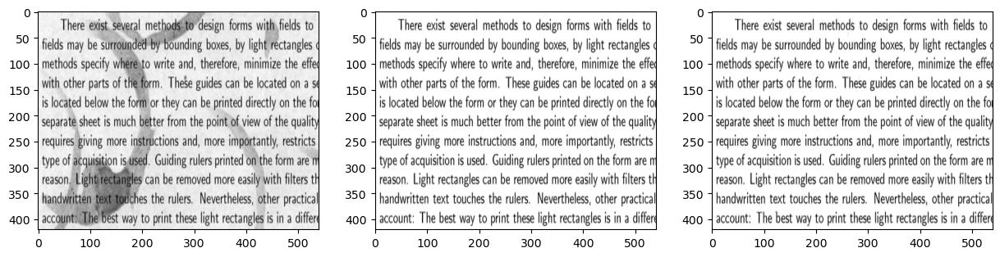

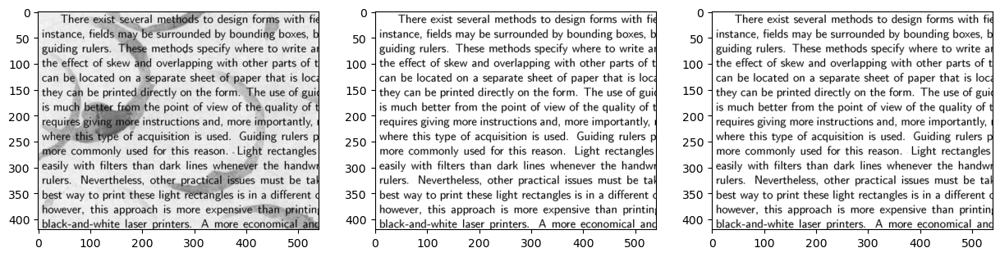

Epoch: 2101, Train loss: 0.006781747564673424, validation loss: 0.006868546362966299, validaiton RMSE: 0.015023541636765003
Epoch: 2102, Train loss: 0.006850415375083685, validation loss: 0.006869491655379534, validaiton RMSE: 0.015008592046797276
Epoch: 2103, Train loss: 0.006622254382818937, validation loss: 0.006865767762064934, validaiton RMSE: 0.015009679831564426
Epoch: 2104, Train loss: 0.006821573246270418, validation loss: 0.006870107725262642, validaiton RMSE: 0.015017290599644184
Epoch: 2105, Train loss: 0.006640606094151735, validation loss: 0.006867443677037954, validaiton RMSE: 0.015017869882285595
Epoch: 2106, Train loss: 0.0066194087266922, validation loss: 0.006867777090519667, validaiton RMSE: 0.015006561763584614
Epoch: 2107, Train loss: 0.006678777746856213, validation loss: 0.006861064117401838, validaiton RMSE: 0.01499864924699068
Epoch: 2108, Train loss: 0.0067948405630886555, validation loss: 0.0068591684103012085, validaiton RMSE: 0.015002972446382046
Epoch: 21

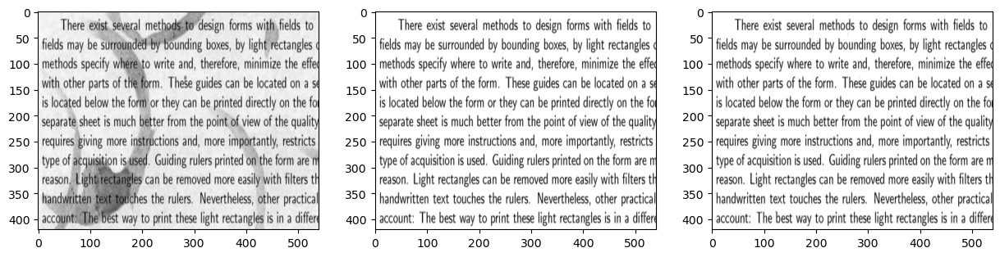

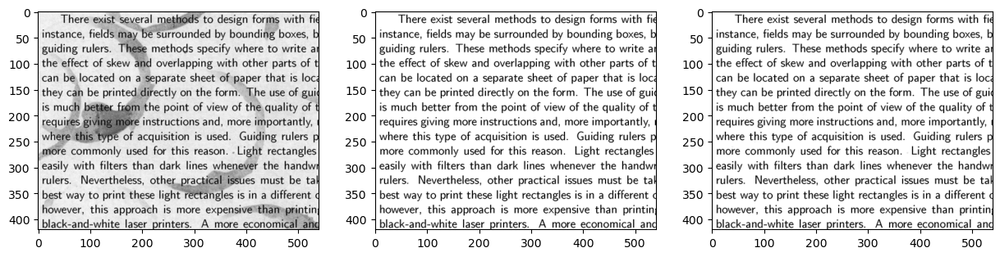

Epoch: 2201, Train loss: 0.006944942753762007, validation loss: 0.006856244057416916, validaiton RMSE: 0.015016716904938221
Epoch: 2202, Train loss: 0.006775572430342436, validation loss: 0.00685901427641511, validaiton RMSE: 0.015013054013252258
Epoch: 2203, Train loss: 0.006840720772743225, validation loss: 0.006863108370453119, validaiton RMSE: 0.015004545450210571
Epoch: 2204, Train loss: 0.006672637537121773, validation loss: 0.006864259485155344, validaiton RMSE: 0.015009771101176739
Epoch: 2205, Train loss: 0.006968626752495766, validation loss: 0.00686510419473052, validaiton RMSE: 0.015010755509138107
Epoch: 2206, Train loss: 0.006759177427738905, validation loss: 0.006866977084428072, validaiton RMSE: 0.01500964630395174
Epoch: 2207, Train loss: 0.0067258477210998535, validation loss: 0.006869500037282705, validaiton RMSE: 0.01501956582069397
Epoch: 2208, Train loss: 0.006793951615691185, validation loss: 0.006870828568935394, validaiton RMSE: 0.015017458237707615
Epoch: 2209

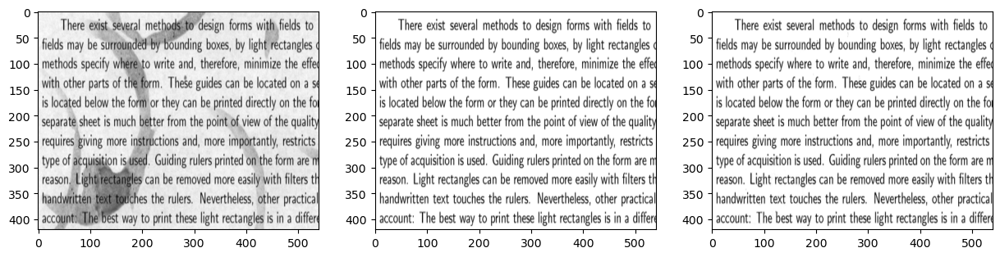

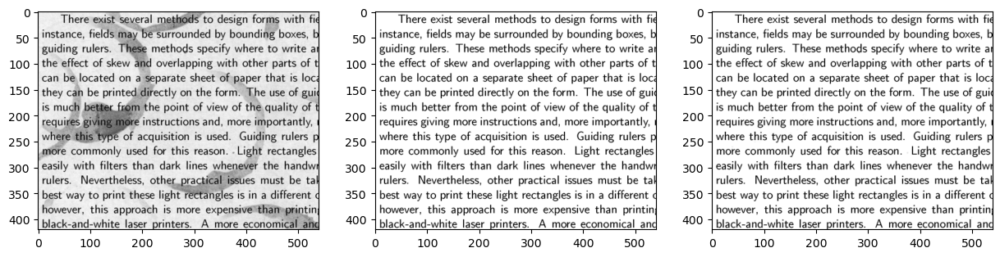

Epoch: 2301, Train loss: 0.006817553658038378, validation loss: 0.006865645293146372, validaiton RMSE: 0.015014953911304474
Epoch: 2302, Train loss: 0.006687638349831104, validation loss: 0.006867630407214165, validaiton RMSE: 0.015018912963569164
Epoch: 2303, Train loss: 0.006662346422672272, validation loss: 0.0068660699762403965, validaiton RMSE: 0.015013236552476883
Epoch: 2304, Train loss: 0.006884743459522724, validation loss: 0.006869425997138023, validaiton RMSE: 0.015035026706755161
Epoch: 2305, Train loss: 0.006826740223914385, validation loss: 0.006866032723337412, validaiton RMSE: 0.015014600940048695
Epoch: 2306, Train loss: 0.006934538949280977, validation loss: 0.0068708136677742004, validaiton RMSE: 0.015009663067758083
Epoch: 2307, Train loss: 0.006703866645693779, validation loss: 0.0068674758076667786, validaiton RMSE: 0.015010964125394821
Epoch: 2308, Train loss: 0.006821058224886656, validation loss: 0.006871139630675316, validaiton RMSE: 0.015013281255960464
Epoch

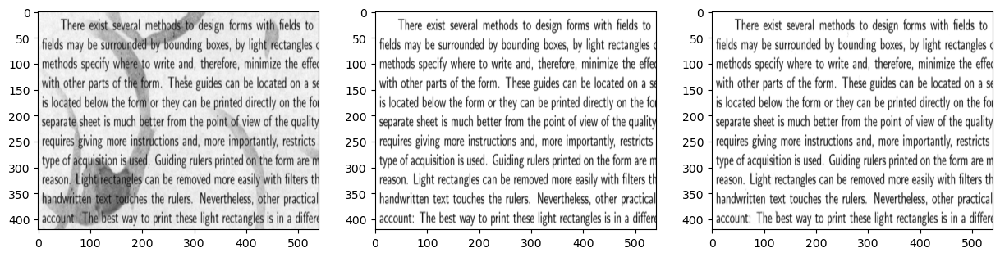

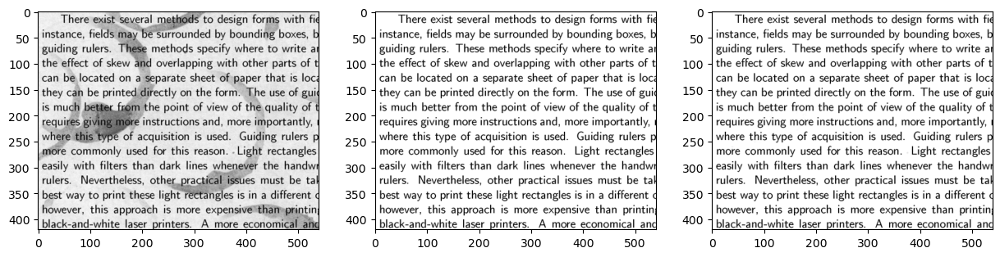

Epoch: 2401, Train loss: 0.006796813104301691, validation loss: 0.006868523079901934, validaiton RMSE: 0.015018131583929062
Epoch: 2402, Train loss: 0.006911789067089558, validation loss: 0.006868438329547644, validaiton RMSE: 0.015028589405119419
Epoch: 2403, Train loss: 0.006686100736260414, validation loss: 0.006863812450319529, validaiton RMSE: 0.015004863031208515
Epoch: 2404, Train loss: 0.006812991574406624, validation loss: 0.006863559130579233, validaiton RMSE: 0.015012870542705059
Epoch: 2405, Train loss: 0.006564510054886341, validation loss: 0.0068627228029072285, validaiton RMSE: 0.015013535507023335
Epoch: 2406, Train loss: 0.006884797941893339, validation loss: 0.0068666995503008366, validaiton RMSE: 0.015013615600764751
Epoch: 2407, Train loss: 0.006852550897747278, validation loss: 0.006865666713565588, validaiton RMSE: 0.015007591806352139
Epoch: 2408, Train loss: 0.0068315682001411915, validation loss: 0.006867609918117523, validaiton RMSE: 0.01500748097896576
Epoch:

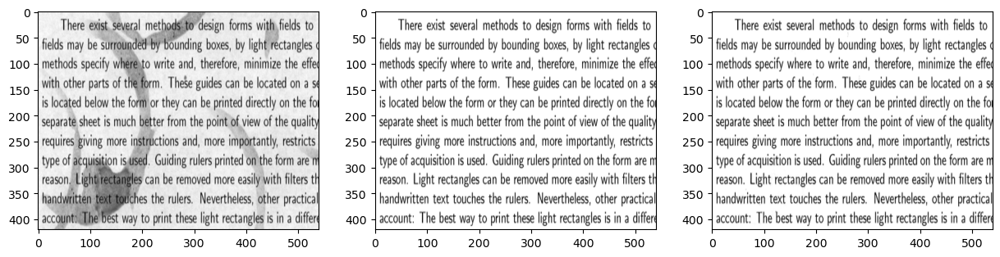

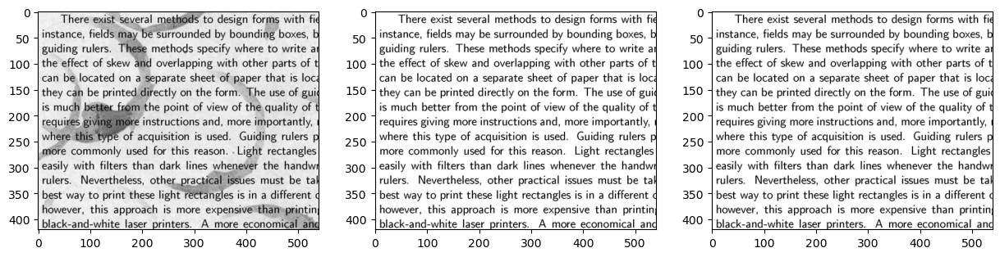

Epoch: 2501, Train loss: 0.006812936160713434, validation loss: 0.0068630496971309185, validaiton RMSE: 0.015013225376605988
Epoch: 2502, Train loss: 0.006745769176632166, validation loss: 0.006867764517664909, validaiton RMSE: 0.015007500536739826
Epoch: 2503, Train loss: 0.006460836157202721, validation loss: 0.006868893746286631, validaiton RMSE: 0.015002667903900146
Epoch: 2504, Train loss: 0.0066719320602715015, validation loss: 0.006869306322187185, validaiton RMSE: 0.015011746436357498
Epoch: 2505, Train loss: 0.006847287528216839, validation loss: 0.006861251313239336, validaiton RMSE: 0.015012170188128948
Epoch: 2506, Train loss: 0.006813584361225367, validation loss: 0.006862688343971968, validaiton RMSE: 0.015018370933830738
Epoch: 2507, Train loss: 0.006819017231464386, validation loss: 0.006861016154289246, validaiton RMSE: 0.0150082902982831
Epoch: 2508, Train loss: 0.0066680265590548515, validation loss: 0.006867455318570137, validaiton RMSE: 0.015007675625383854
Epoch: 

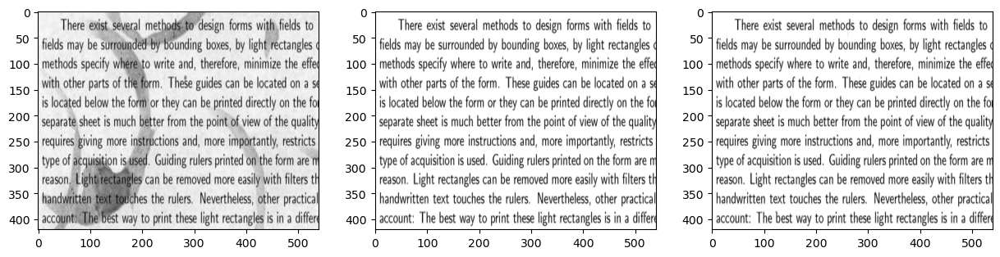

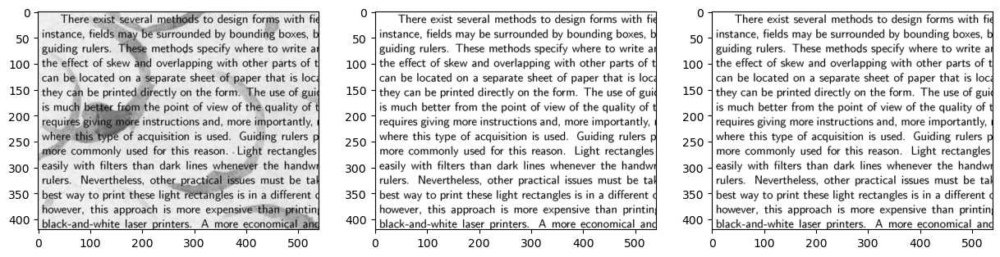

Epoch: 2601, Train loss: 0.006798291113227606, validation loss: 0.006863494869321585, validaiton RMSE: 0.01500749122351408
Epoch: 2602, Train loss: 0.006799924187362194, validation loss: 0.006864023860543966, validaiton RMSE: 0.015007846988737583
Epoch: 2603, Train loss: 0.006971192546188831, validation loss: 0.006860056892037392, validaiton RMSE: 0.0150153124704957
Epoch: 2604, Train loss: 0.006767806597054005, validation loss: 0.006863594055175781, validaiton RMSE: 0.01500741671770811
Epoch: 2605, Train loss: 0.006676316726952791, validation loss: 0.0068650394678115845, validaiton RMSE: 0.015020530670881271
Epoch: 2606, Train loss: 0.006737443618476391, validation loss: 0.006863811518996954, validaiton RMSE: 0.015016702003777027
Epoch: 2607, Train loss: 0.006761672906577587, validation loss: 0.006858909968286753, validaiton RMSE: 0.015013505704700947
Epoch: 2608, Train loss: 0.006801702547818422, validation loss: 0.0068617151118814945, validaiton RMSE: 0.01501293946057558
Epoch: 2609

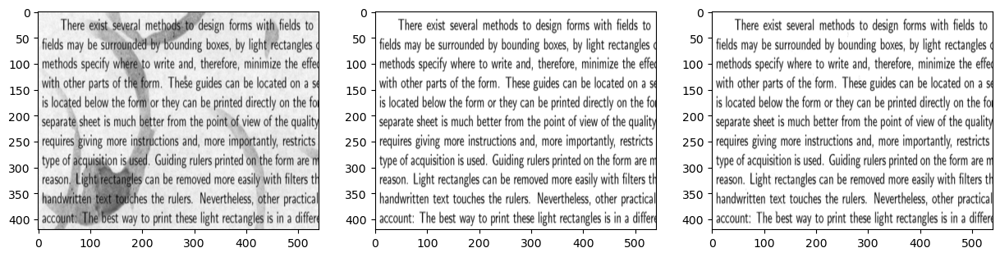

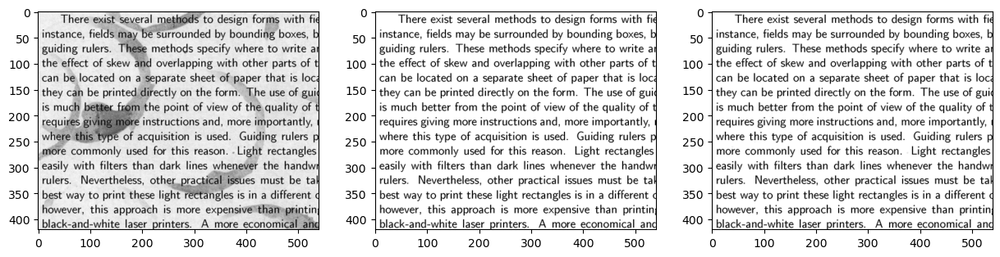

Epoch: 2701, Train loss: 0.006770480889827013, validation loss: 0.006865309085696936, validaiton RMSE: 0.015013636089861393
Epoch: 2702, Train loss: 0.006823029834777117, validation loss: 0.006866960320621729, validaiton RMSE: 0.015015676617622375
Epoch: 2703, Train loss: 0.0069380044005811214, validation loss: 0.0068603805266320705, validaiton RMSE: 0.01500367745757103
Epoch: 2704, Train loss: 0.006797706708312035, validation loss: 0.006862208247184753, validaiton RMSE: 0.01501428335905075
Epoch: 2705, Train loss: 0.006913724355399609, validation loss: 0.006870117038488388, validaiton RMSE: 0.015011638402938843
Epoch: 2706, Train loss: 0.006853729952126741, validation loss: 0.006867821794003248, validaiton RMSE: 0.01501056645065546
Epoch: 2707, Train loss: 0.006644436623901129, validation loss: 0.006865502800792456, validaiton RMSE: 0.015010795556008816
Epoch: 2708, Train loss: 0.006659817881882191, validation loss: 0.006862596143037081, validaiton RMSE: 0.015005302615463734
Epoch: 27

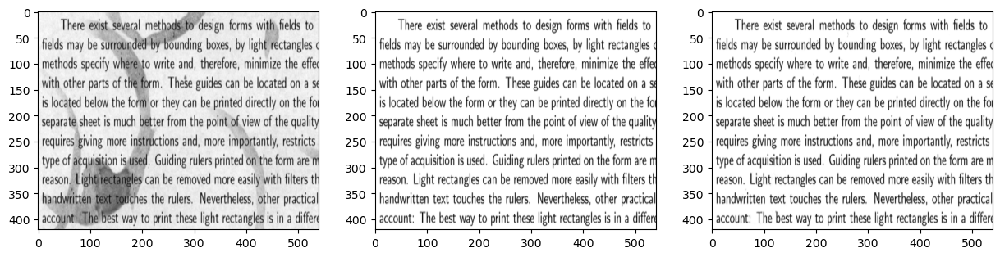

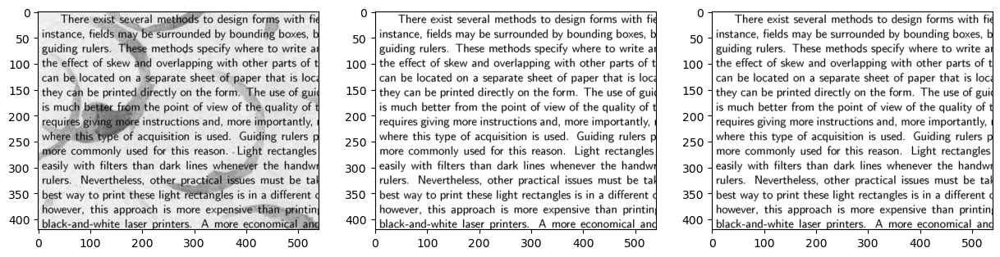

Epoch: 2801, Train loss: 0.006547124590724707, validation loss: 0.0068677072413265705, validaiton RMSE: 0.015008819289505482
Epoch: 2802, Train loss: 0.006966154091060162, validation loss: 0.0068687740713357925, validaiton RMSE: 0.015018547885119915
Epoch: 2803, Train loss: 0.006851436570286751, validation loss: 0.006874090060591698, validaiton RMSE: 0.015016286633908749
Epoch: 2804, Train loss: 0.006856761407107115, validation loss: 0.006872035562992096, validaiton RMSE: 0.015012645162642002
Epoch: 2805, Train loss: 0.006730739958584309, validation loss: 0.006867947056889534, validaiton RMSE: 0.015020658262073994
Epoch: 2806, Train loss: 0.0067264544777572155, validation loss: 0.006870914250612259, validaiton RMSE: 0.015022329986095428
Epoch: 2807, Train loss: 0.006854729261249304, validation loss: 0.0068679810501635075, validaiton RMSE: 0.015015282668173313
Epoch: 2808, Train loss: 0.006803928408771753, validation loss: 0.006862969603389502, validaiton RMSE: 0.015018469654023647
Epoc

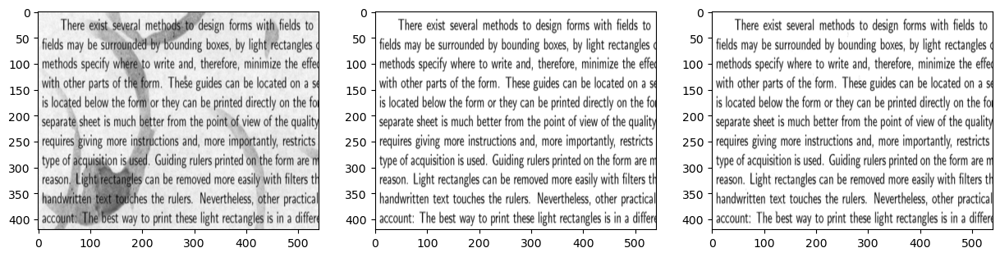

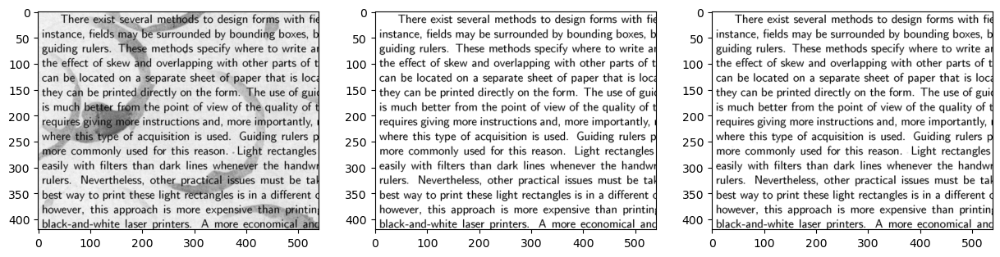

Epoch: 2901, Train loss: 0.006753388326615095, validation loss: 0.006868826225399971, validaiton RMSE: 0.01502148900181055
Epoch: 2902, Train loss: 0.006876667961478233, validation loss: 0.006866481155157089, validaiton RMSE: 0.01503147091716528
Epoch: 2903, Train loss: 0.0067160832695662975, validation loss: 0.006861233618110418, validaiton RMSE: 0.015024791471660137
Epoch: 2904, Train loss: 0.006848517339676619, validation loss: 0.0068595632910728455, validaiton RMSE: 0.015016135759651661
Epoch: 2905, Train loss: 0.006734054069966078, validation loss: 0.006864896509796381, validaiton RMSE: 0.015012462623417377
Epoch: 2906, Train loss: 0.006737824063748121, validation loss: 0.0068677873350679874, validaiton RMSE: 0.015018784441053867
Epoch: 2907, Train loss: 0.00672677019611001, validation loss: 0.006858567241579294, validaiton RMSE: 0.015004822053015232
Epoch: 2908, Train loss: 0.006689460948109627, validation loss: 0.006866576615720987, validaiton RMSE: 0.01501549780368805
Epoch: 29

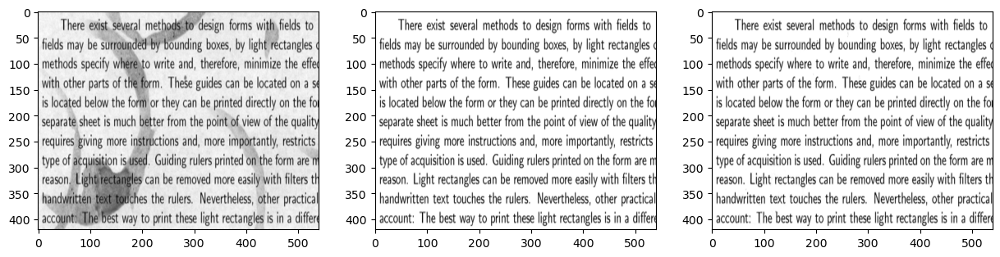

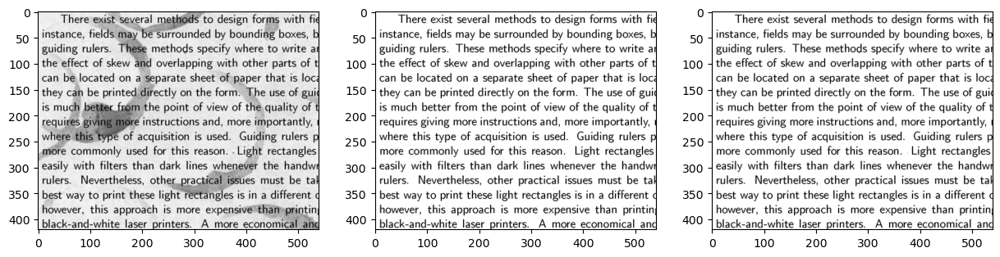

Epoch: 3001, Train loss: 0.006590564269572496, validation loss: 0.006861624773591757, validaiton RMSE: 0.015008709393441677
Epoch: 3002, Train loss: 0.006703719962388277, validation loss: 0.006856892257928848, validaiton RMSE: 0.014999933540821075
Epoch: 3003, Train loss: 0.006683690939098597, validation loss: 0.006859462708234787, validaiton RMSE: 0.01500872801989317
Epoch: 3004, Train loss: 0.0067961872555315495, validation loss: 0.006865276023745537, validaiton RMSE: 0.015012490563094616
Epoch: 3005, Train loss: 0.0068334611132740974, validation loss: 0.006865059956908226, validaiton RMSE: 0.01501534879207611
Epoch: 3006, Train loss: 0.0069002327509224415, validation loss: 0.006864792201668024, validaiton RMSE: 0.015014353208243847
Epoch: 3007, Train loss: 0.0065633696503937244, validation loss: 0.006864657625555992, validaiton RMSE: 0.015019695274531841
Epoch: 3008, Train loss: 0.006729991640895605, validation loss: 0.0068596950732171535, validaiton RMSE: 0.01501247938722372
Epoch:

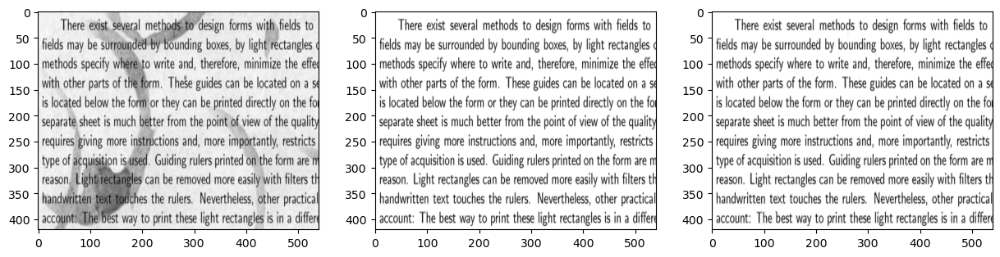

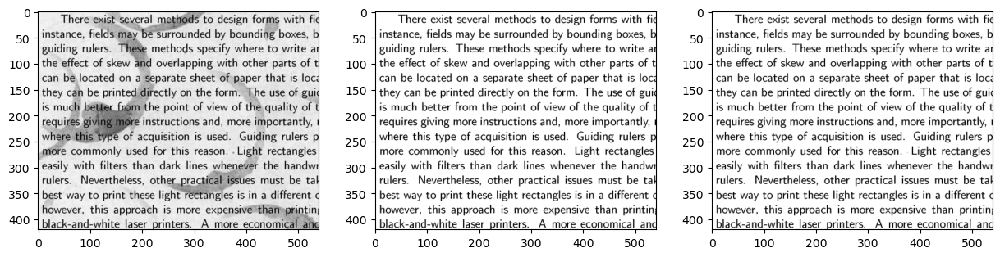

Epoch: 3101, Train loss: 0.006940599996596575, validation loss: 0.006863596383482218, validaiton RMSE: 0.01500962395220995
Epoch: 3102, Train loss: 0.006924367975443602, validation loss: 0.006860828027129173, validaiton RMSE: 0.015009301714599133
Epoch: 3103, Train loss: 0.006840555462986231, validation loss: 0.006864979397505522, validaiton RMSE: 0.015019814483821392
Epoch: 3104, Train loss: 0.006844766438007355, validation loss: 0.0068669915199279785, validaiton RMSE: 0.015019967220723629
Epoch: 3105, Train loss: 0.00685078464448452, validation loss: 0.0068639288656413555, validaiton RMSE: 0.015014640986919403
Epoch: 3106, Train loss: 0.006794141139835119, validation loss: 0.006861228961497545, validaiton RMSE: 0.015008755028247833
Epoch: 3107, Train loss: 0.006793176755309105, validation loss: 0.006866407115012407, validaiton RMSE: 0.015016411431133747
Epoch: 3108, Train loss: 0.006717688869684935, validation loss: 0.006865580100566149, validaiton RMSE: 0.01502464059740305
Epoch: 31

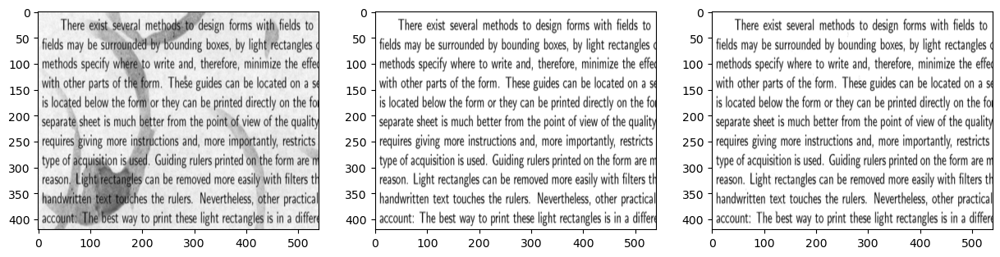

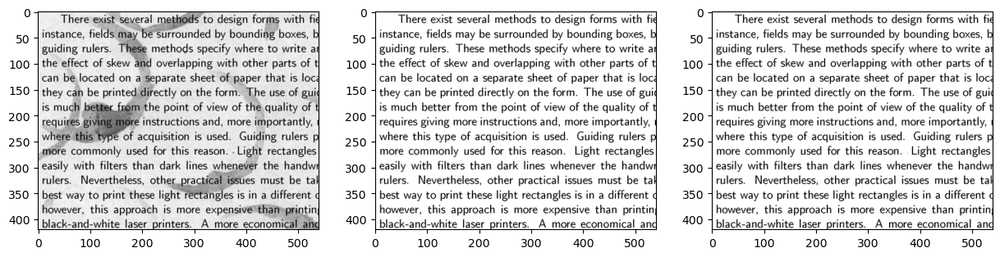

Epoch: 3201, Train loss: 0.006787235848605633, validation loss: 0.006863048300147057, validaiton RMSE: 0.015008460730314255
Epoch: 3202, Train loss: 0.006962499115616083, validation loss: 0.006861623842269182, validaiton RMSE: 0.015013955533504486
Epoch: 3203, Train loss: 0.006991534028202295, validation loss: 0.006865285336971283, validaiton RMSE: 0.015016131103038788
Epoch: 3204, Train loss: 0.006736543495208025, validation loss: 0.00686281593516469, validaiton RMSE: 0.01502251997590065
Epoch: 3205, Train loss: 0.006820236332714558, validation loss: 0.006867649033665657, validaiton RMSE: 0.015030722133815289
Epoch: 3206, Train loss: 0.00659028859809041, validation loss: 0.006865174975246191, validaiton RMSE: 0.015017145313322544
Epoch: 3207, Train loss: 0.006747202482074499, validation loss: 0.00686097564175725, validaiton RMSE: 0.015020869672298431
Epoch: 3208, Train loss: 0.00661500496789813, validation loss: 0.006868395488709211, validaiton RMSE: 0.015008571557700634
Epoch: 3209, 

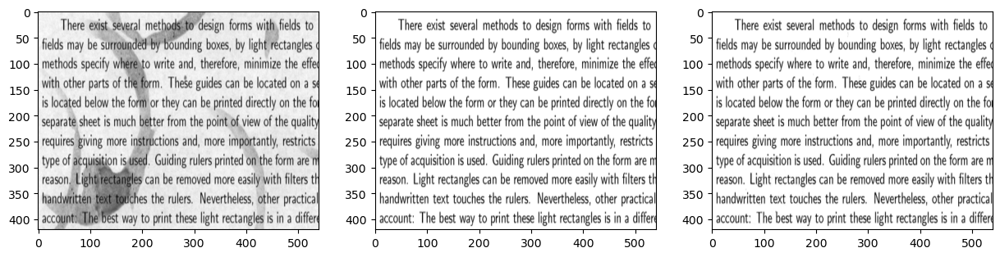

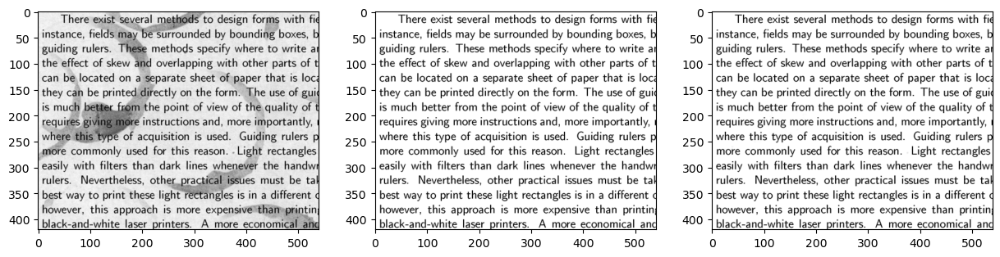

Epoch: 3301, Train loss: 0.006873416714370251, validation loss: 0.006864148657768965, validaiton RMSE: 0.01501335296779871
Epoch: 3302, Train loss: 0.006674415897578001, validation loss: 0.006858490873128176, validaiton RMSE: 0.015000291168689728
Epoch: 3303, Train loss: 0.006862609181553125, validation loss: 0.006862377282232046, validaiton RMSE: 0.015003982931375504
Epoch: 3304, Train loss: 0.0069421823136508465, validation loss: 0.00686322757974267, validaiton RMSE: 0.015017080120742321
Epoch: 3305, Train loss: 0.006603780202567577, validation loss: 0.006866197567433119, validaiton RMSE: 0.015009447932243347
Epoch: 3306, Train loss: 0.006789917126297951, validation loss: 0.00686533423140645, validaiton RMSE: 0.01500856876373291
Epoch: 3307, Train loss: 0.00673447223380208, validation loss: 0.006858017295598984, validaiton RMSE: 0.015005089342594147
Epoch: 3308, Train loss: 0.006833879742771387, validation loss: 0.006869075819849968, validaiton RMSE: 0.015015392564237118
Epoch: 3309,

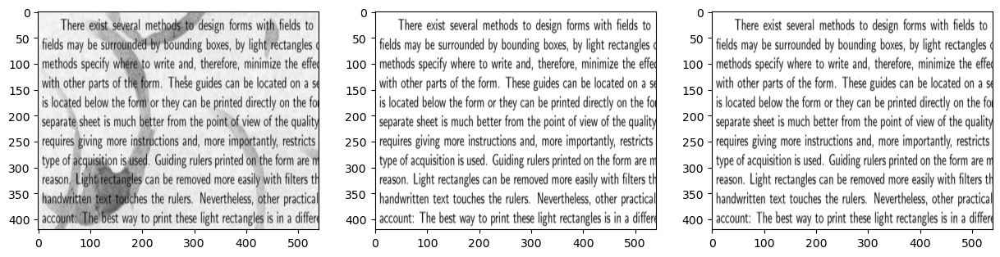

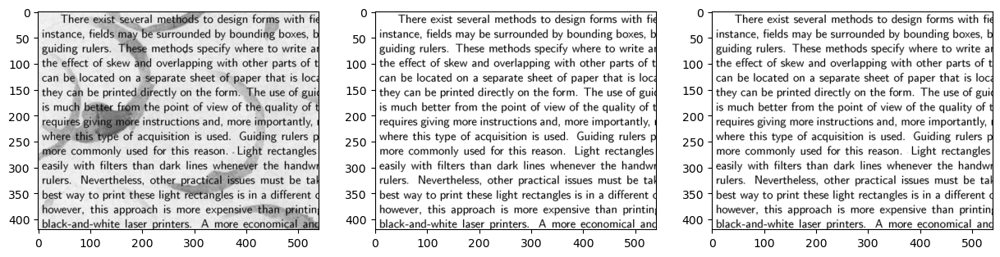

Epoch: 3401, Train loss: 0.00672631012275815, validation loss: 0.006860923022031784, validaiton RMSE: 0.015010460279881954
Epoch: 3402, Train loss: 0.006872374098747969, validation loss: 0.006866531912237406, validaiton RMSE: 0.015017257072031498
Epoch: 3403, Train loss: 0.0067939963191747665, validation loss: 0.006863572169095278, validaiton RMSE: 0.015010029077529907
Epoch: 3404, Train loss: 0.006653205957263708, validation loss: 0.006868410389870405, validaiton RMSE: 0.015021677128970623
Epoch: 3405, Train loss: 0.0068306331522762775, validation loss: 0.006863474380224943, validaiton RMSE: 0.015018690377473831
Epoch: 3406, Train loss: 0.006684194318950176, validation loss: 0.006868637632578611, validaiton RMSE: 0.015012629330158234
Epoch: 3407, Train loss: 0.0067656515166163445, validation loss: 0.006866642739623785, validaiton RMSE: 0.01500912755727768
Epoch: 3408, Train loss: 0.006812718231230974, validation loss: 0.006867790594696999, validaiton RMSE: 0.01502284500747919
Epoch: 3

KeyboardInterrupt: 

In [14]:
from torch.optim.lr_scheduler import ReduceLROnPlateau


criterion = nn.MSELoss()
RMSE = RMSELoss()
ssim_loss = SSIMLoss()
optimizer = optim.Adam(model.parameters(), lr=9e-4, weight_decay=1e-5)

scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.05, patience=50, verbose=True)

for i in range(num_epoch):
    # Train
    model.train()
    train_losses = []
    for k,(image, label) in enumerate(train_loader):
        optimizer.zero_grad()
        image, label = image.to(device), label.to(device)

        # batch_images = []
        # for img in image:
        #     img_np = img.permute(1, 2, 0).cpu().numpy()  # Tensor to NumPy
        #     img_np = (img_np * 255).astype(np.uint8)  # Scale to [0, 255]
        #     background_removed_img = remove_background(img_np)  # Apply background removal
        #     batch_images.append(torch.tensor(background_removed_img / 255, dtype=torch.float32).unsqueeze(0))  # Normalize and add channel  # Normalize and add channel

        # image = torch.stack(batch_images).to(device)
        
        output = model.forward(image)
        loss = criterion(output, label) + ssim_loss(output, label)
        loss.backward()
        optimizer.step()
        train_losses.append(loss.cpu().detach().numpy())

    # Evaluation
    model.eval() 
    val_RMSE = []
    val_losses = []
    for k ,(image, label) in enumerate(validation_loader):
        with torch.no_grad(): 
            image, label = image.to(device), label.to(device)

            # Apply background removal to validation images
            # batch_images = []
            # for img in image:
            #     img_np = img.permute(1, 2, 0).cpu().numpy()
            #     img_np = (img_np * 255).astype(np.uint8)
            #     background_removed_img = remove_background(img_np)
            #     batch_images.append(torch.tensor(background_removed_img / 255, dtype=torch.float32).unsqueeze(0))  # Normalize and add channel

            # image = torch.stack(batch_images).to(device)
            
            output = model.forward(image)
            loss = criterion(output, label) + ssim_loss(output, label)
            val_RMSE.append(RMSE(output, label).cpu().detach().numpy())
            val_losses.append(loss.cpu().detach().numpy())
            
    tran_loss = np.array(train_losses).mean()
    val_RMSE = np.array(val_RMSE).mean()
    val_loss = np.array(val_losses).mean()

    total_train_loss.append(tran_loss)
    total_RMSE.append(val_RMSE)
    total_val_loss.append(val_loss)
    
    print(f"Epoch: {str(i)}, Train loss: {tran_loss}, validation loss: {val_loss}, validaiton RMSE: {val_RMSE}")

    # 모델 저장
    if(val_loss < best_loss):
        print("Save new param")
        torch.save(model,'./unet_param.pkl')
        best_loss = val_loss

    scheduler.step(val_loss)

    # Denoised image 시각화
    if i % 100 == 0:
        out_img = torch.squeeze(output)
        for q in range(2):
            plt.figure(figsize=(15,25))
            plt.subplot(1,3,1)
            plt.imshow(torch.squeeze(image[q]).cpu().detach().numpy(), cmap='gray')
            plt.subplot(1,3,2)
            plt.imshow(torch.squeeze(label[q]).cpu().detach().numpy(), cmap='gray')
            plt.subplot(1,3,3)
            plt.imshow(torch.squeeze(out_img[q]).cpu().detach().numpy(), cmap='gray')
            plt.show()

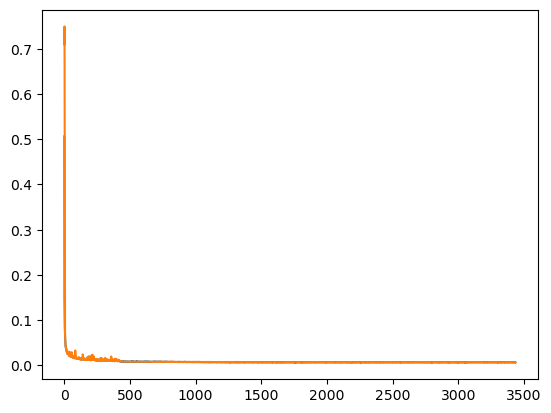

In [15]:
plt.plot(total_train_loss)
plt.plot(total_val_loss)

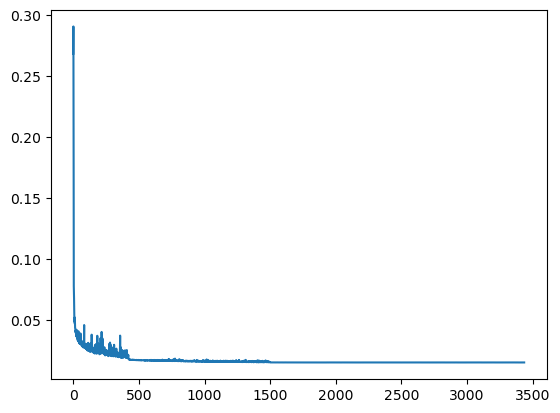

In [16]:
plt.plot(total_RMSE)

In [17]:
# 6. 후처리 단계: Bilateral Filter 예시
def apply_bilateral_filter(tensor_image):
    image_np = tensor_image.cpu().detach().numpy().transpose(1, 2, 0)
    filtered_image = cv2.bilateralFilter(image_np, d=9, sigmaColor=75, sigmaSpace=75)
    return torch.tensor(filtered_image).permute(2, 0, 1)

In [18]:
num_workers = 0
batch_size = 8

test_transform = transforms.Compose([
    transforms.Grayscale(),
    transforms.ToTensor()
    ])

class Dataset_test(Dataset):
    def __init__(self, file_dir, transform=None):
        self.input_list = sorted(glob(file_dir + '/*.png'))
        self.transform = transform

    def __len__(self):
        return len(self.input_list)
    
    def __getitem__(self, idx):
        image = Image.open(self.input_list[idx]).convert('RGB')
        
        if self.transform:
            image = self.transform(image)
        
        # local 환경에서 사용할 경우, 아래 코드 사용 (test dataset의 경로가 './test')
        # image_id = re.findall(r'\d+', self.input_list[idx])[0]
        
        # Kaggle notebook에서 사용할 경우, 아래 코드 사용
        image_id = re.findall(r'\d+', self.input_list[idx].split('competition')[-1])[0]
        return image, image_id

# local 환경에서 사용할 경우, 아래 코드 사용 (test dataset의 경로가 './test')
# test_dataset = Dataset_test(file_dir='./test', transform=test_transform)
test_dataset = Dataset_test(file_dir='../Desktop/sw_week/2024-hallym-sw-week-competition/test', transform=test_transform)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size = batch_size, num_workers = num_workers, shuffle = False, drop_last = False)

In [28]:
import cv2

# It will take a while!
num_elements = 7115040

ids = np.empty(num_elements, dtype=object)
vals = np.empty(num_elements, dtype=float)
index = 0

# 파라메터 불러오기
model = torch.load('../Desktop/unet_param.pkl').to(device)
for k ,(image, image_id) in enumerate(test_loader):
    with torch.no_grad(): 
        model.eval()   
        
        output = model.forward(image.to(device))
        output = torch.squeeze(output).cpu().detach().numpy()
        
        # Bilateral Filter 적용
#         filtered_output = cv2.bilateralFilter(output, d=9, sigmaColor=75, sigmaSpace=75)
        
        for r in range(output.shape[0]):
            for c in range(output.shape[1]):
                ids[index] = image_id[0] + '_' + str(r + 1) + '_' + str(c + 1)
                vals[index] = output[r, c]
                index += 1

ValueError: setting an array element with a sequence.

In [ ]:
submission = pd.DataFrame({'id': ids, 'value': vals})

In [ ]:
submission.to_csv('./nice_gill_submission.csv',index = False)

In [20]:
output = model.forward(image.to(device))

In [21]:
output.shape

torch.Size([8, 1, 420, 540])